<a href="https://colab.research.google.com/github/hakureikaze/CS230/blob/main/WGAN_Gradient_penalty.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw




Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
HTTP Error 503: Service Unavailable




Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
HTTP Error 503: Service Unavailable




Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw

Processing...
Done!


/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:502: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:143.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        inputs=mixed_images,
        outputs=mixed_scores,
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    
    penalty = torch.mean(torch.square(gradient_norm - 1))
    
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    
    gen_loss = -torch.mean(crit_fake_pred)
    
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [12]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    
    crit_loss = torch.mean(crit_fake_pred - crit_real_pred) + gp * c_lambda
    
    return crit_loss

In [13]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.09948955371044577, critic loss: 1.9307130507230768


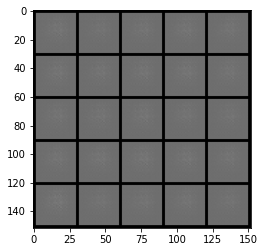

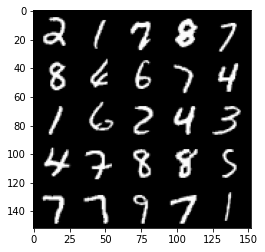

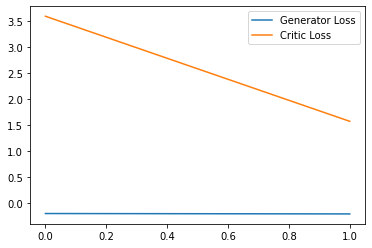

Step 100: Generator loss: 1.8397376865148545, critic loss: -3.432426427841187


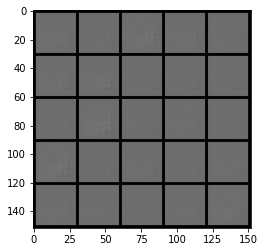

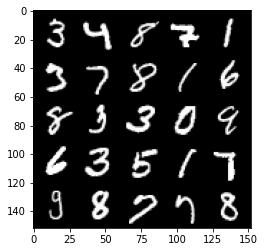

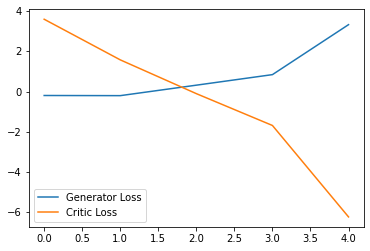

Step 150: Generator loss: 1.8667086207866668, critic loss: -11.117609392166134


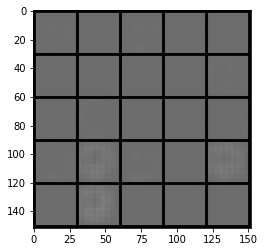

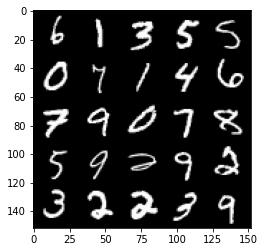

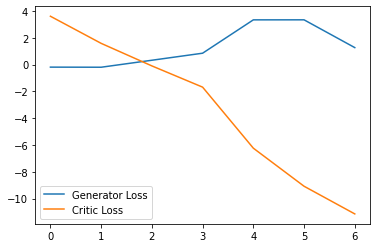

Step 200: Generator loss: -0.02132350541651249, critic loss: -27.39980178070068


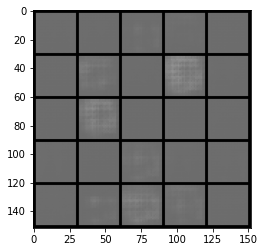

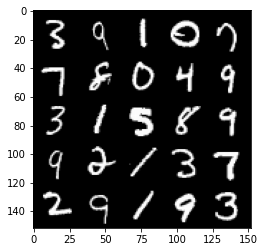

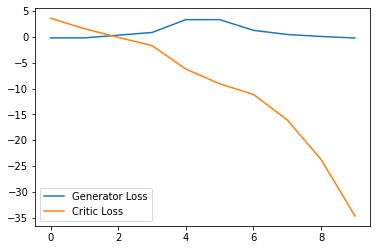

Step 250: Generator loss: 0.9978845077753067, critic loss: -58.37033448791503


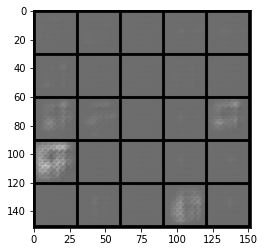

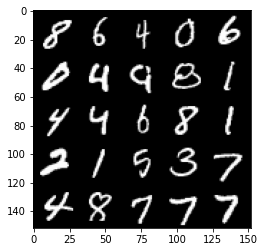

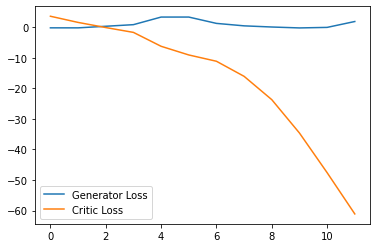

Step 300: Generator loss: 2.9170159685611723, critic loss: -98.66980349731445


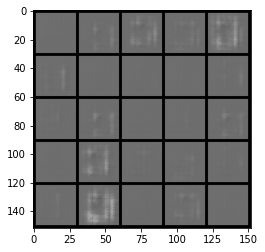

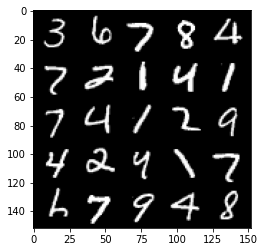

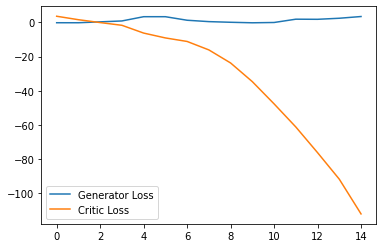

Step 350: Generator loss: 6.995090312957764, critic loss: -144.62816366577147


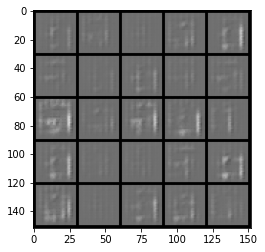

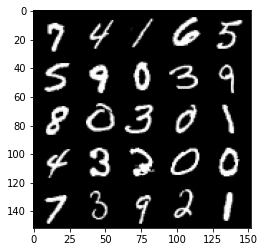

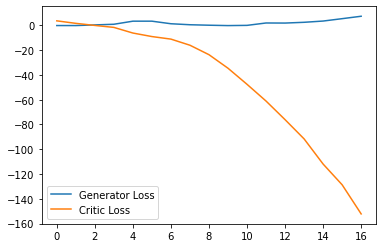

Step 400: Generator loss: 12.09492820739746, critic loss: -198.98239642333976


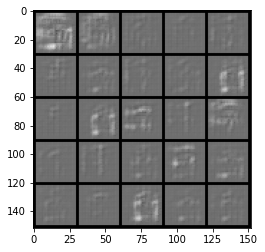

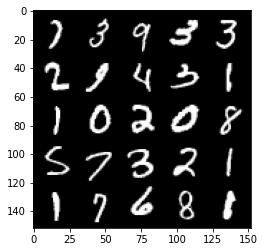

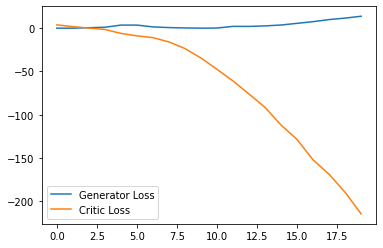

Step 450: Generator loss: 14.445829811096191, critic loss: -249.09696136474614


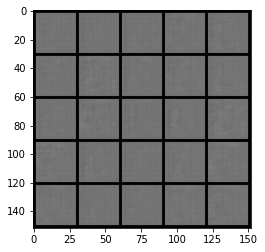

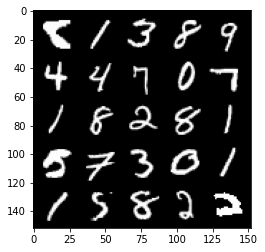

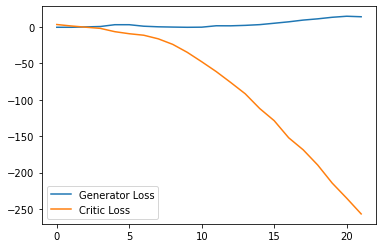

Step 500: Generator loss: 18.518000926971435, critic loss: -289.21378527832024


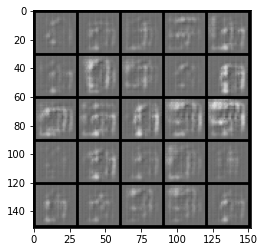

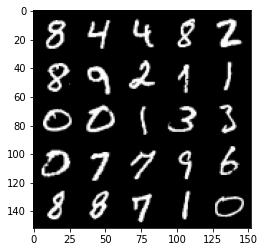

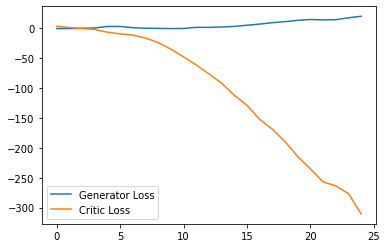

Step 550: Generator loss: -4.843193678855896, critic loss: -277.1337793273926


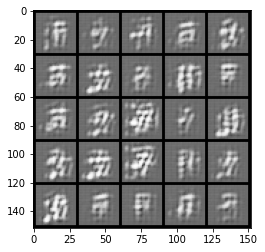

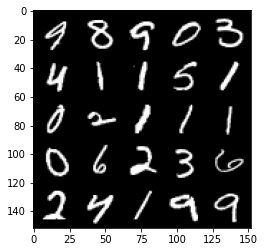

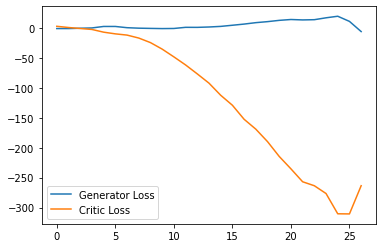

Step 600: Generator loss: -20.40942105293274, critic loss: -238.09945054626462


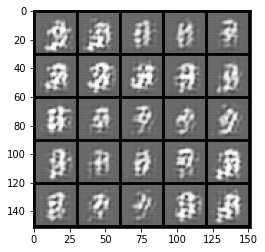

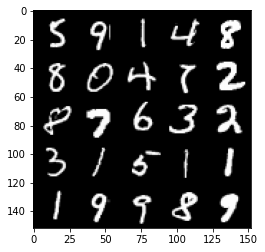

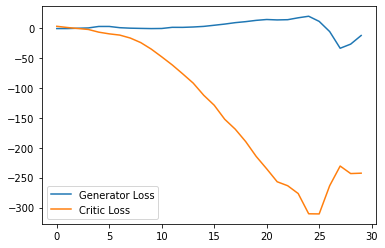

Step 650: Generator loss: 18.562552223205568, critic loss: -278.101838256836


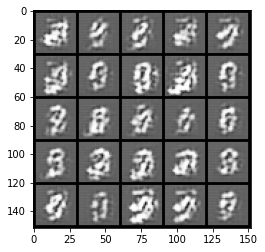

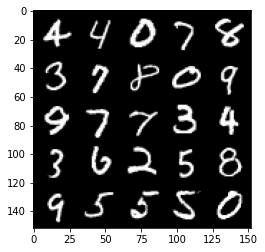

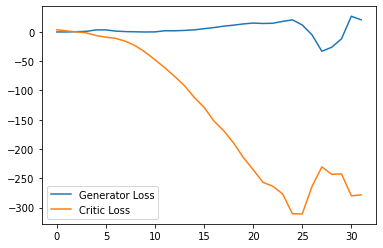

Step 700: Generator loss: 7.150039050579071, critic loss: -311.6567038574218


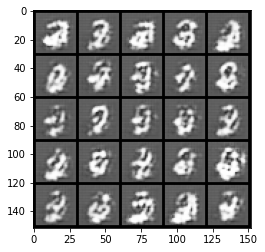

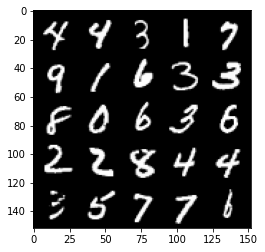

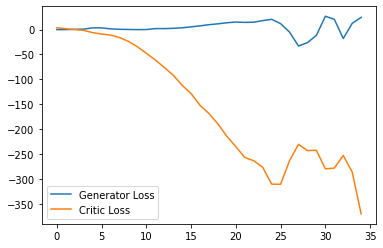

Step 750: Generator loss: -20.266703691482544, critic loss: -262.86916238403325


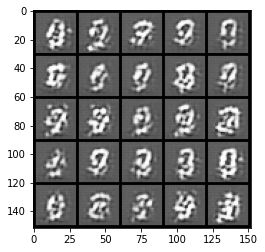

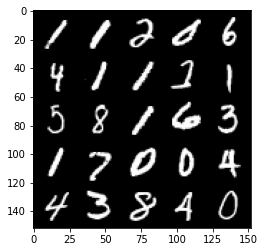

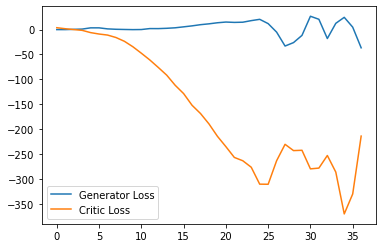

Step 800: Generator loss: -1.3202114951610566, critic loss: -266.7768402099608


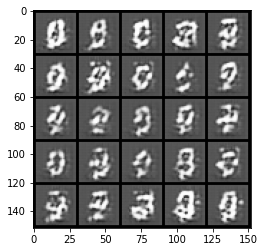

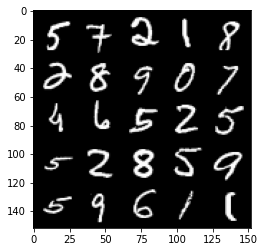

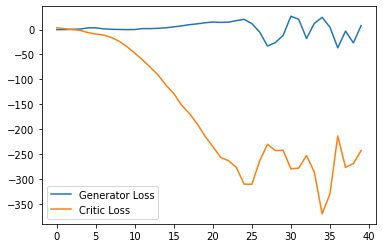

Step 850: Generator loss: -4.435963916778564, critic loss: -272.6681983642578


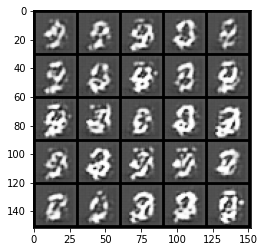

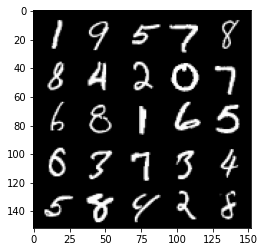

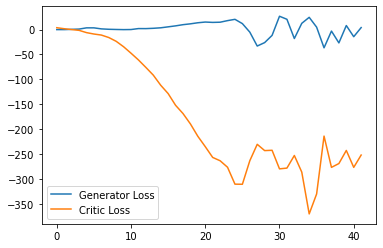

Step 900: Generator loss: -22.55942467212677, critic loss: -249.47009561157236


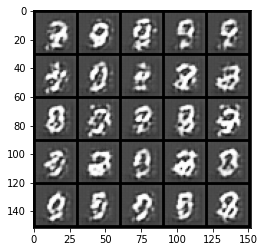

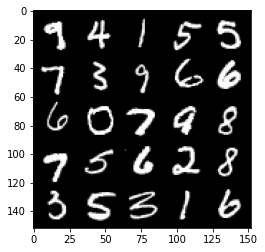

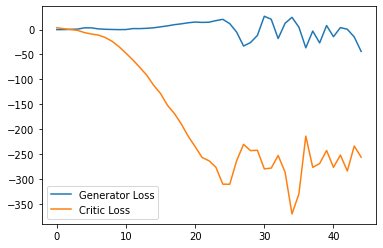

Step 950: Generator loss: -22.892507870197296, critic loss: -166.31213114929204


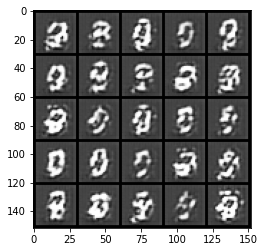

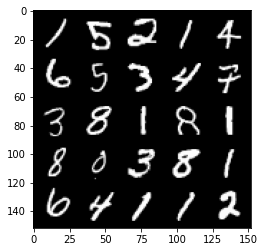

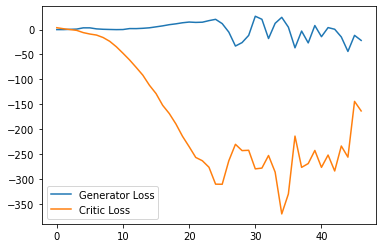

Step 1000: Generator loss: -41.817944606244566, critic loss: -176.68252125549316


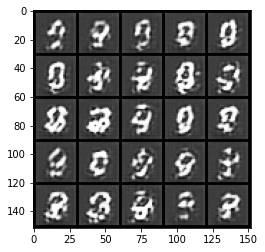

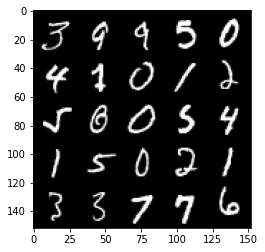

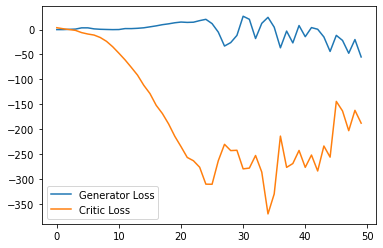

Step 1050: Generator loss: -26.42108661353588, critic loss: -106.6163241653442


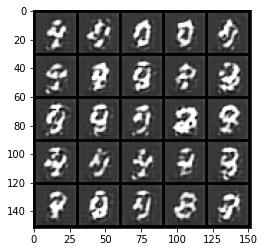

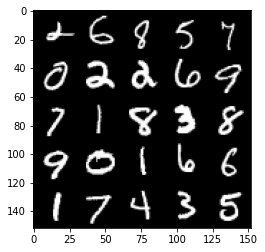

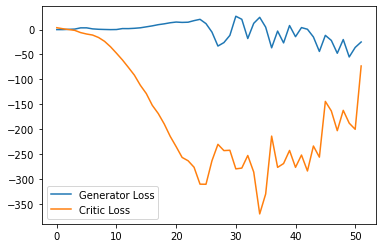

Step 1100: Generator loss: 2.6389027571678163, critic loss: 9.076580612182617


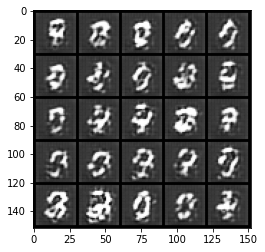

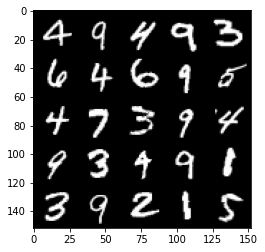

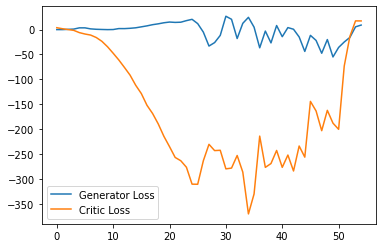

Step 1150: Generator loss: -3.426220241487026, critic loss: -5.9408163223266595


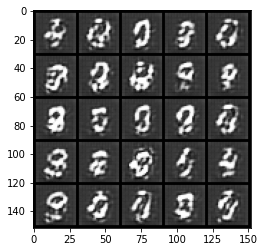

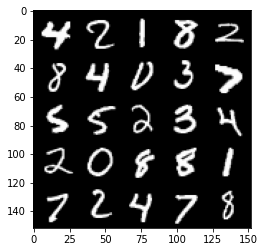

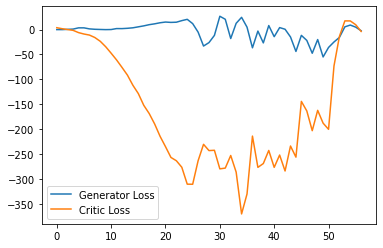

Step 1200: Generator loss: -45.38700380802155, critic loss: -111.36766880798342


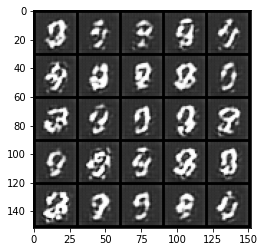

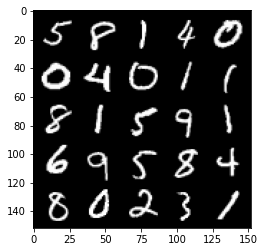

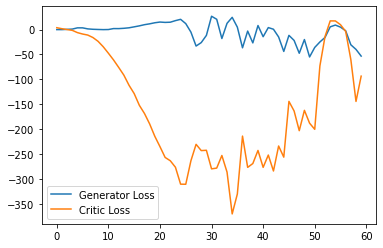

Step 1250: Generator loss: -60.31568604707718, critic loss: -122.5935700073242


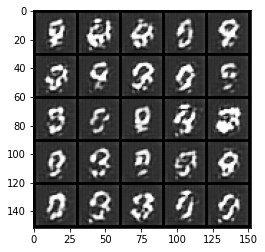

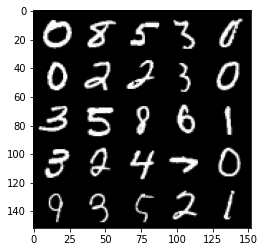

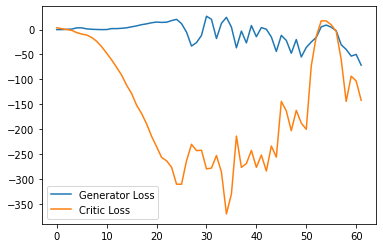

Step 1300: Generator loss: -31.707466351985932, critic loss: -22.155300449371328


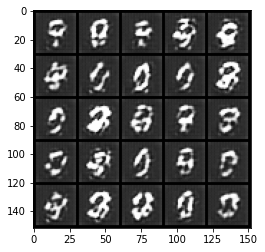

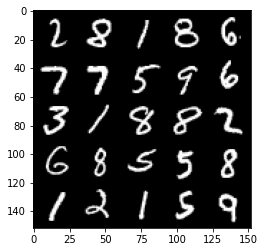

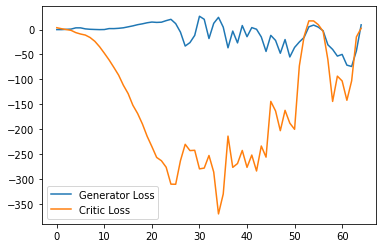

Step 1350: Generator loss: -30.139964423179627, critic loss: -36.88329960632324


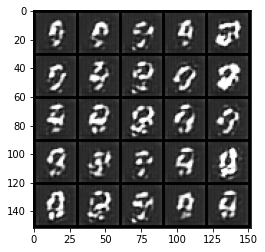

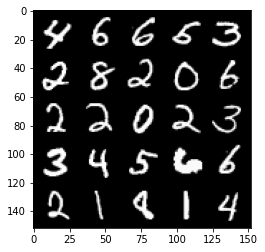

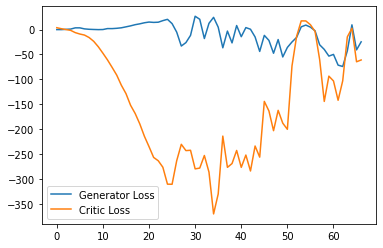

Step 1400: Generator loss: 24.03859672546387, critic loss: 14.923339290618896


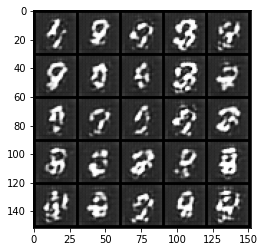

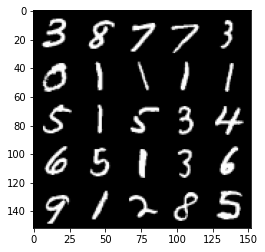

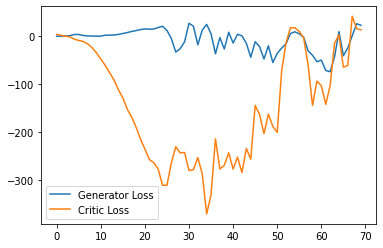

Step 1450: Generator loss: 12.411728725433349, critic loss: 3.7905750122070327


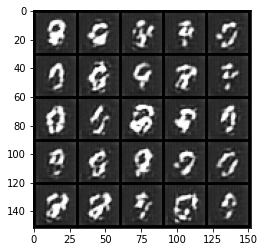

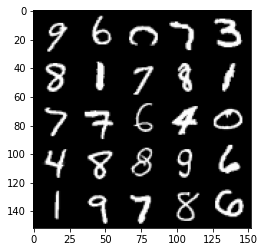

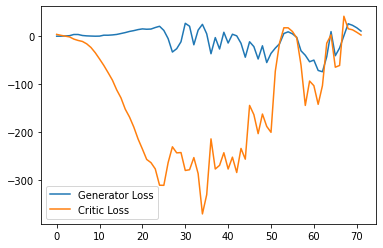

Step 1500: Generator loss: 0.6551195013523102, critic loss: -10.52663609313965


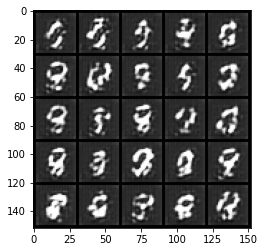

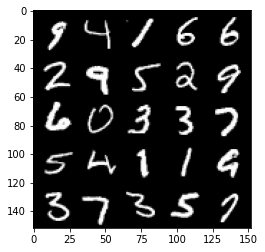

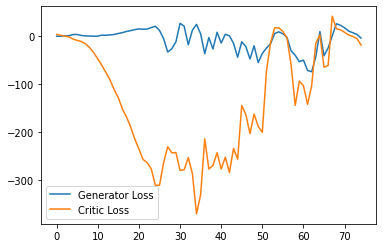

Step 1550: Generator loss: -14.852406606674194, critic loss: -38.30716780471802


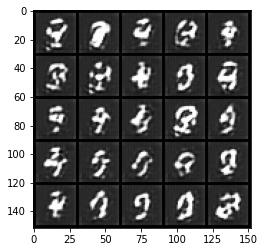

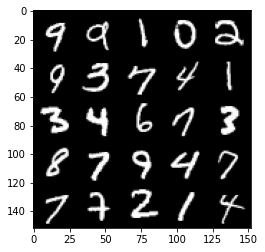

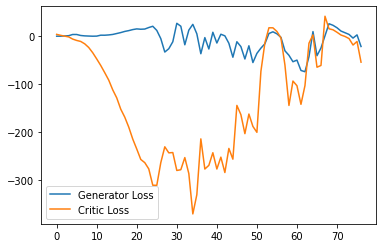

Step 1600: Generator loss: 3.501638946533203, critic loss: 22.096911390304566


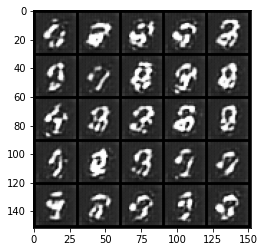

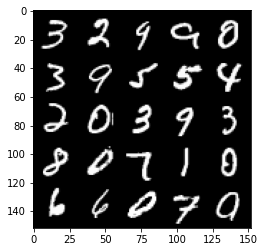

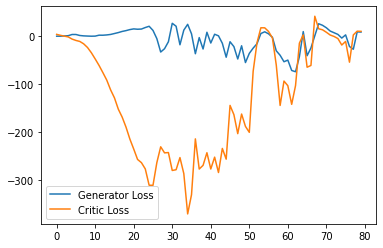

Step 1650: Generator loss: 5.855842232704163, critic loss: 6.953578506469727


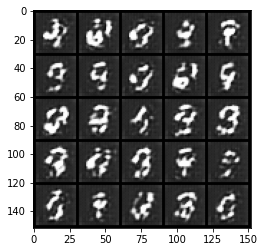

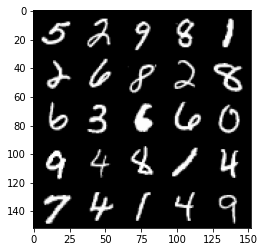

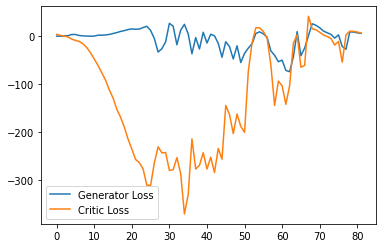

Step 1700: Generator loss: -0.6444603745639325, critic loss: 3.650824340820313


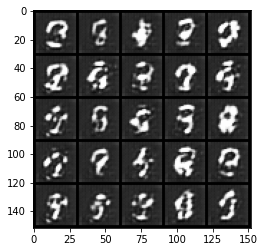

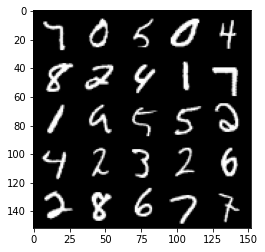

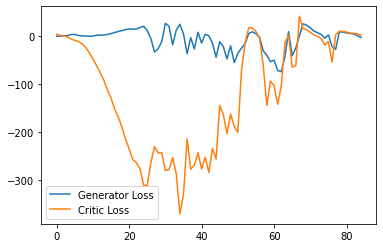

Step 1750: Generator loss: -17.65537045955658, critic loss: -17.97972067642212


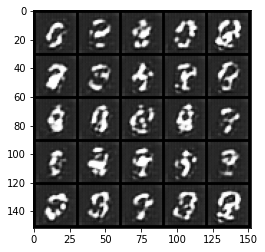

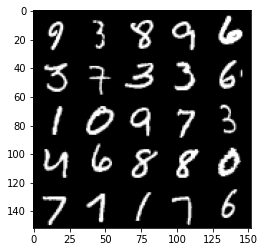

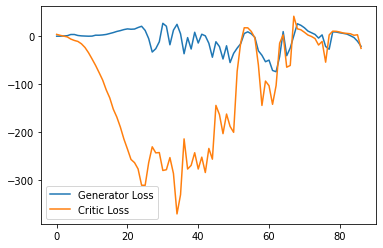

Step 1800: Generator loss: -31.639081844091415, critic loss: -22.726668190002428


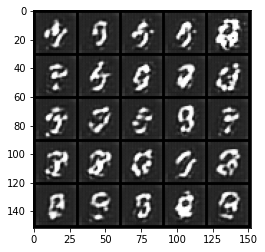

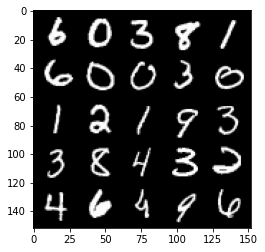

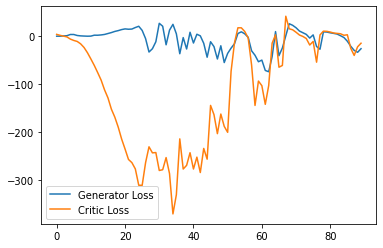

Step 1850: Generator loss: -13.526662281751634, critic loss: -12.295243469238283


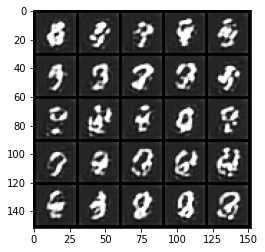

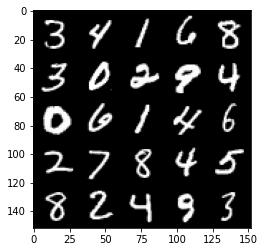

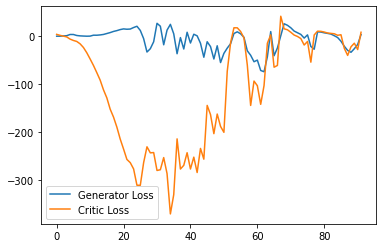

Step 1900: Generator loss: -15.615437213778495, critic loss: -20.795165264129636


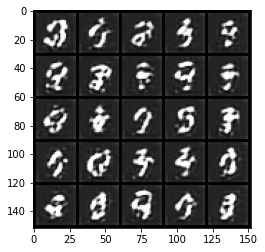

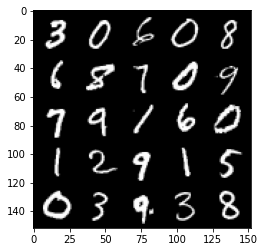

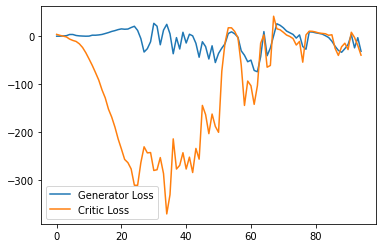

Step 1950: Generator loss: -2.168525400161743, critic loss: 2.2782213249206524


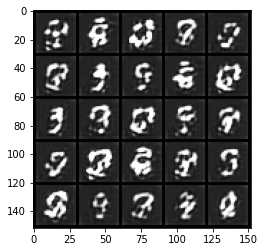

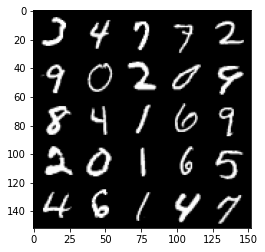

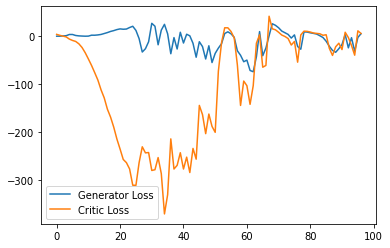

Step 2000: Generator loss: -16.26603503525257, critic loss: 12.971692382812495


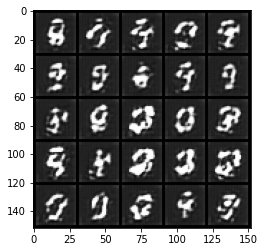

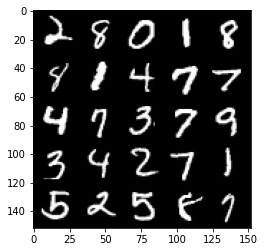

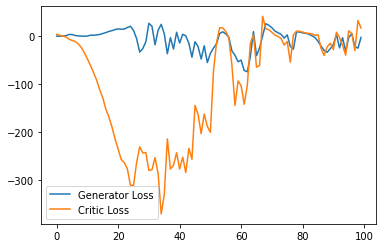

Step 2050: Generator loss: -4.0082799386978145, critic loss: 10.410118327140808


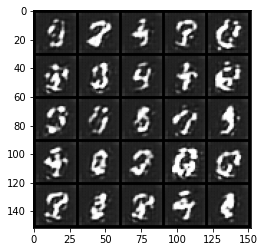

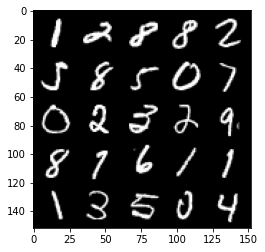

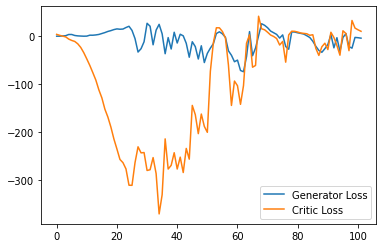

Step 2100: Generator loss: -4.741936283111572, critic loss: 3.4948742618560793


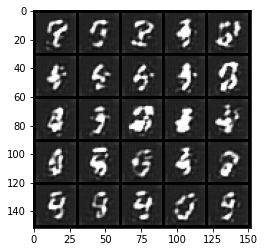

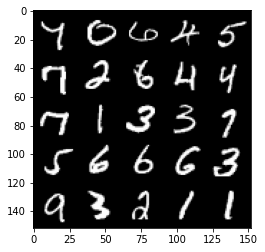

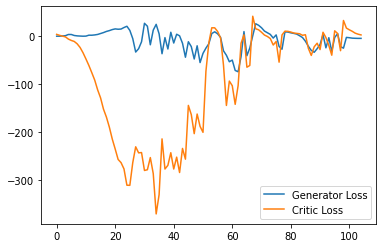

Step 2150: Generator loss: -4.710470542907715, critic loss: 0.8918300838470461


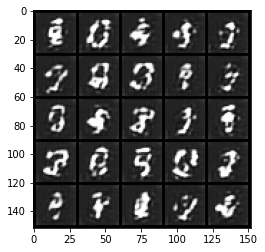

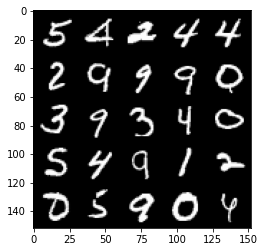

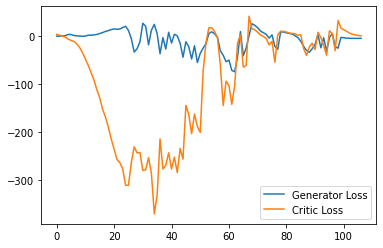

Step 2200: Generator loss: -5.096876745223999, critic loss: 0.4012984466552734


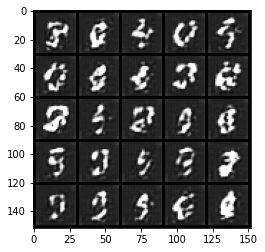

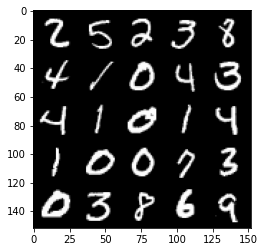

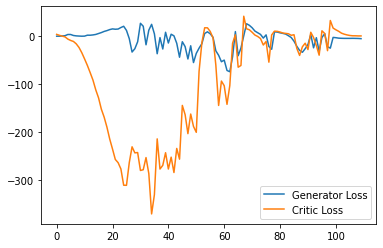

Step 2250: Generator loss: -6.131577224731445, critic loss: 0.14520253849029538


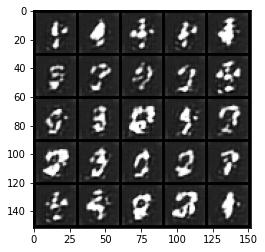

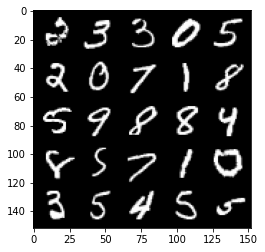

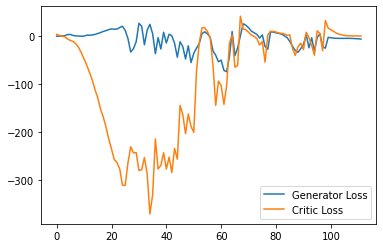

Step 2300: Generator loss: -8.007264919281006, critic loss: 0.35218629169464116


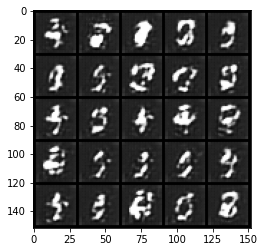

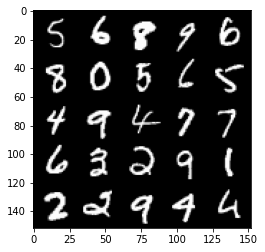

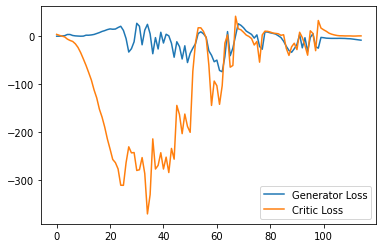

Step 2350: Generator loss: -10.346938037872315, critic loss: 0.31876459217071534


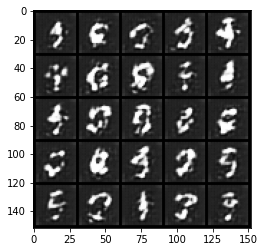

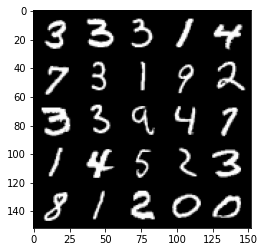

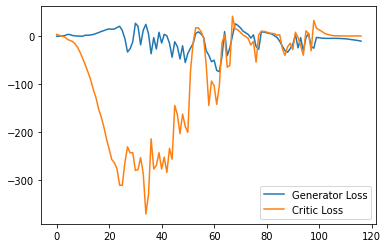

Step 2400: Generator loss: -13.20471393585205, critic loss: 0.33640810251235953


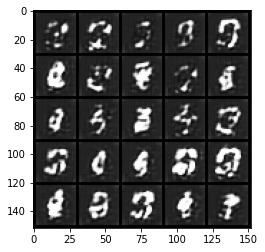

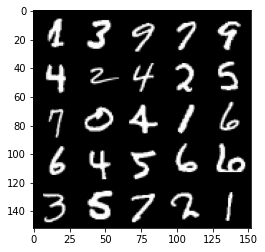

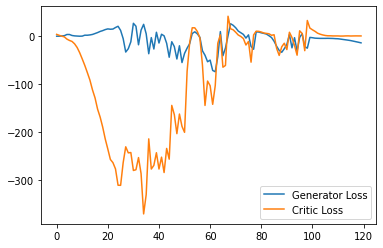

Step 2450: Generator loss: -16.055830078125, critic loss: -0.05708753204345701


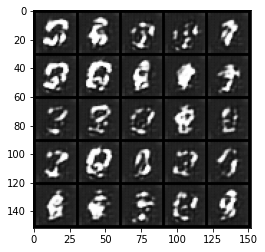

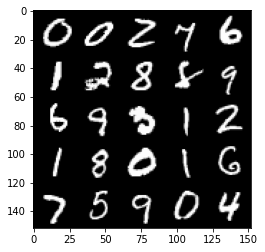

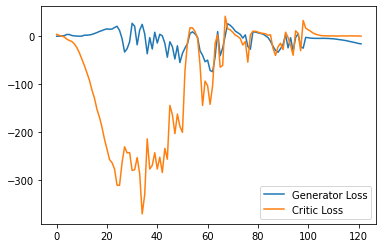

Step 2500: Generator loss: -18.171481323242187, critic loss: -0.9698411493301394


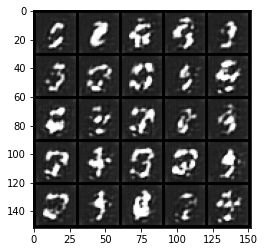

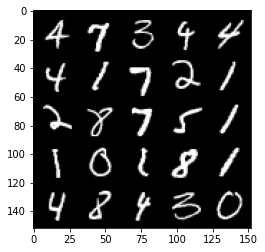

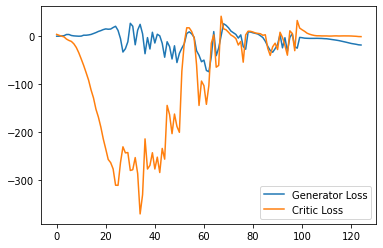

Step 2550: Generator loss: -19.92030448913574, critic loss: -1.7025426244735717


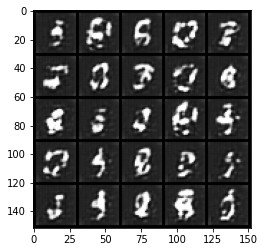

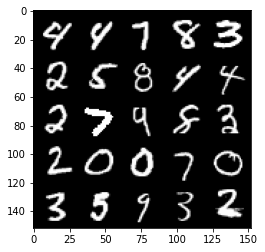

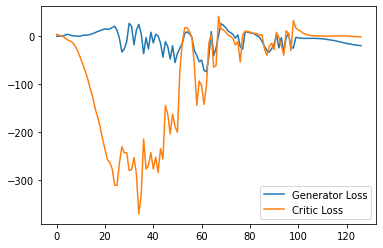

Step 2600: Generator loss: -21.03607479095459, critic loss: -2.569288438796998


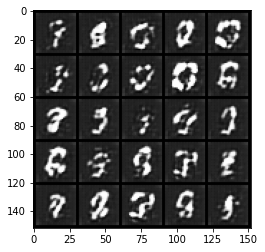

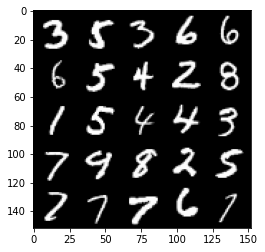

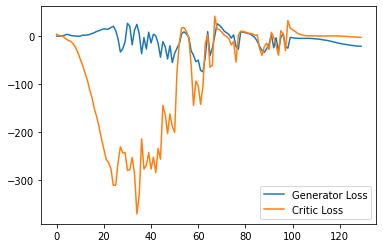

Step 2650: Generator loss: -21.854643516540527, critic loss: -3.3186868515014645


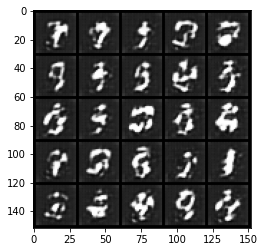

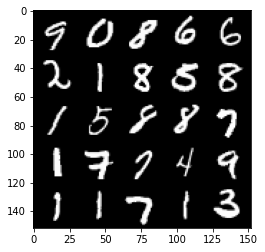

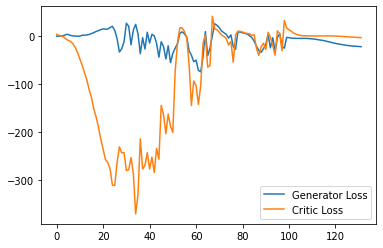

Step 2700: Generator loss: -21.116616897583008, critic loss: -4.048797604560853


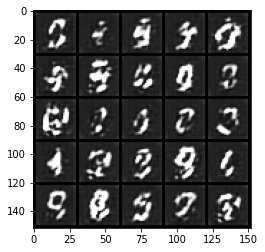

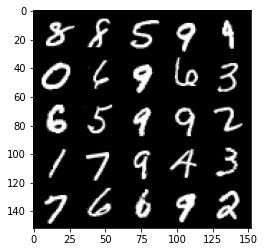

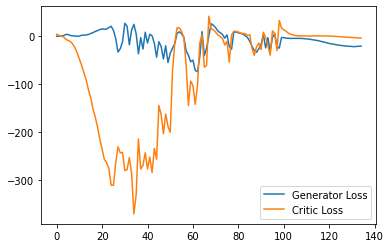

Step 2750: Generator loss: -21.935737991333006, critic loss: -4.560784359931946


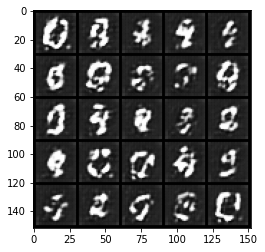

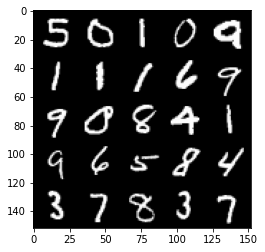

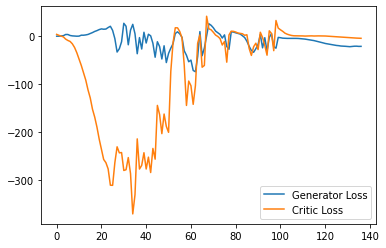

Step 2800: Generator loss: -24.72441711425781, critic loss: -5.109866389274597


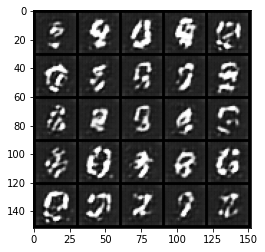

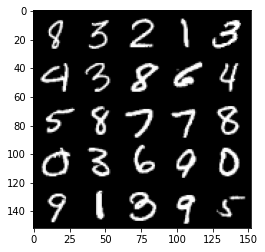

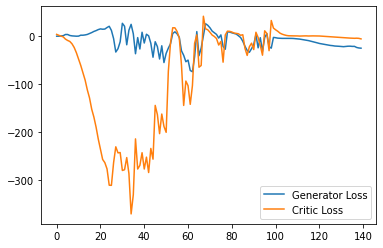

Step 2850: Generator loss: -25.68801200866699, critic loss: -3.9073774261474603


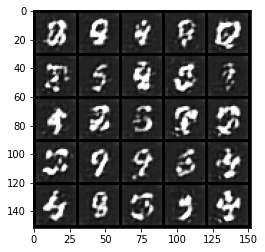

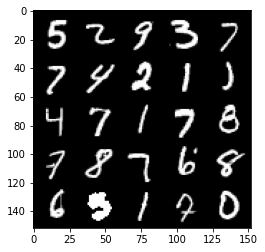

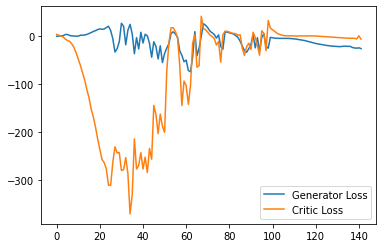

Step 2900: Generator loss: -27.747358283996583, critic loss: -9.44148389816284


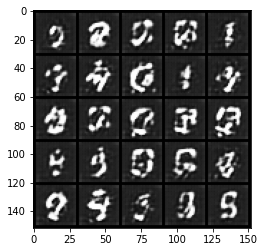

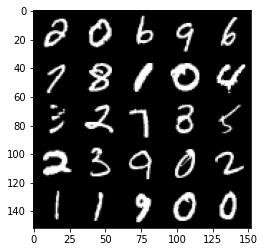

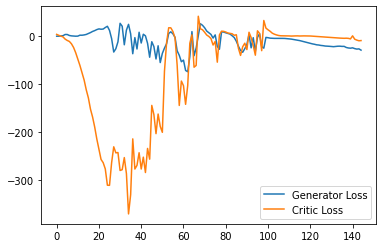

Step 2950: Generator loss: -28.405342559814454, critic loss: -9.890198265075682


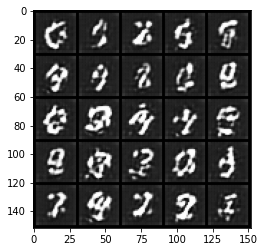

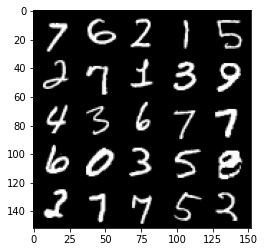

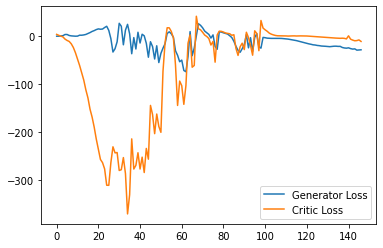

Step 3000: Generator loss: -26.89124225616455, critic loss: -11.939919469833375


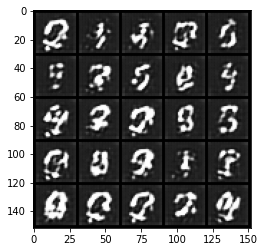

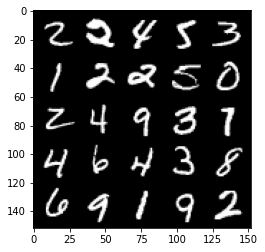

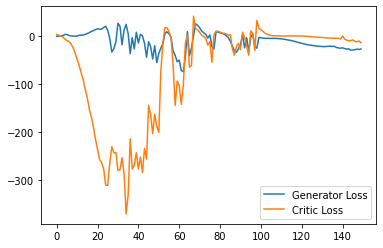

Step 3050: Generator loss: -25.9863134765625, critic loss: -10.812876888275145


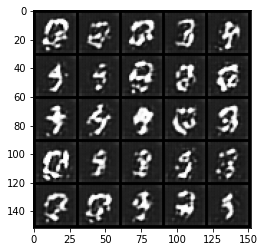

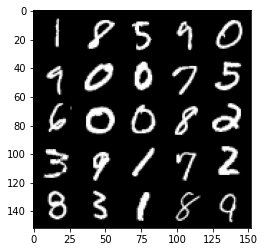

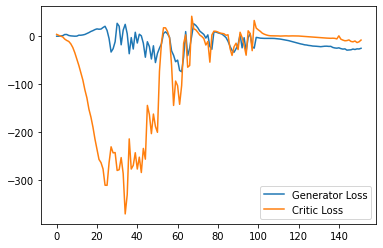

Step 3100: Generator loss: -25.1527099609375, critic loss: -13.275788576126095


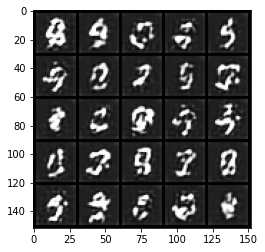

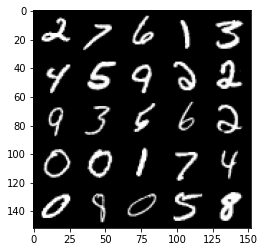

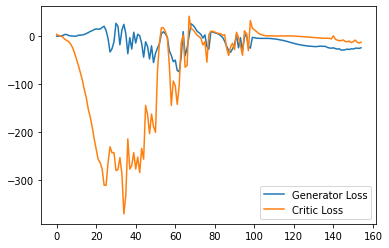

Step 3150: Generator loss: -22.953174571990967, critic loss: -13.837882329940793


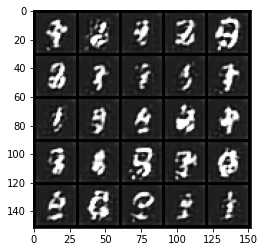

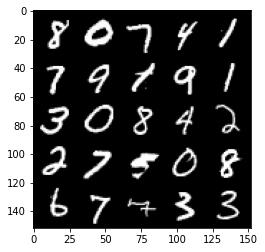

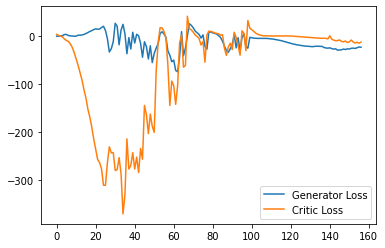

Step 3200: Generator loss: -21.288516063690185, critic loss: -11.554433500289917


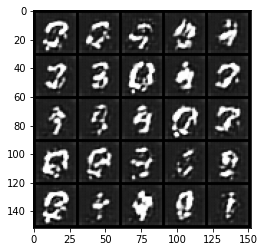

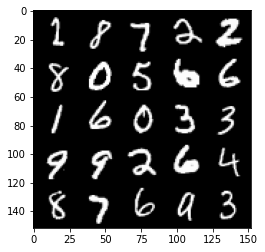

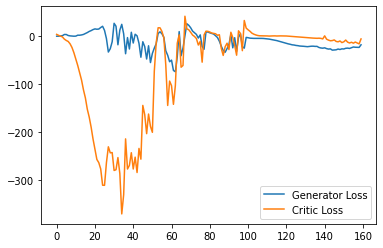

Step 3250: Generator loss: -22.684880790710448, critic loss: -12.955610465049734


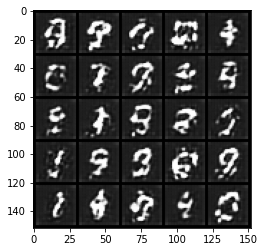

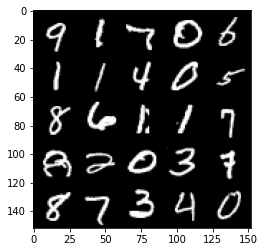

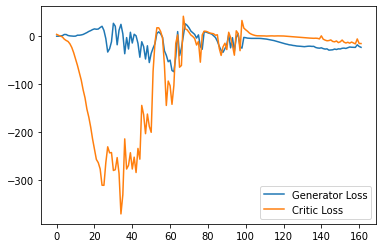

Step 3300: Generator loss: -21.909816703796388, critic loss: -16.26298072528839


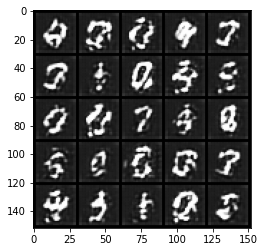

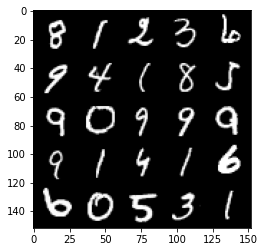

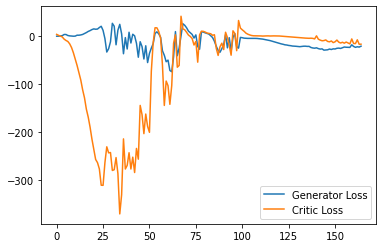

Step 3350: Generator loss: -20.201119556427003, critic loss: -15.639205724716186


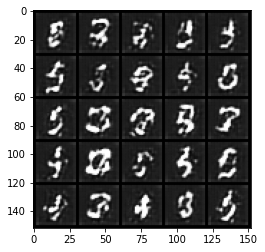

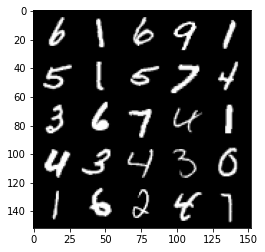

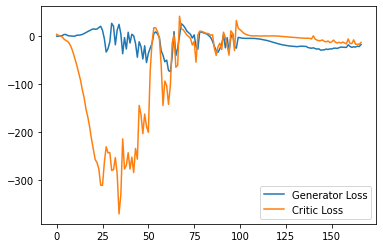

Step 3400: Generator loss: -22.186938343048094, critic loss: -17.223660423278808


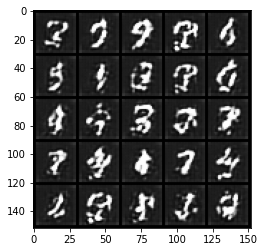

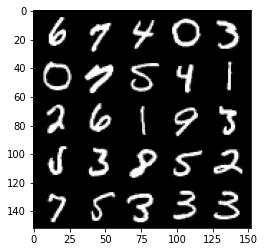

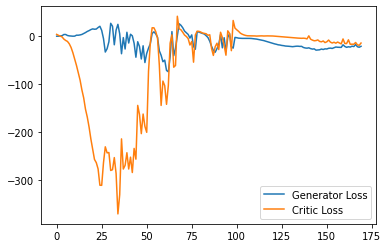

Step 3450: Generator loss: -20.444870796203613, critic loss: -19.971829290390016


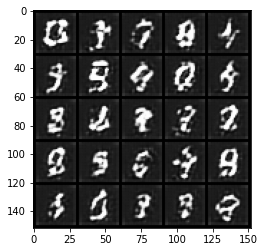

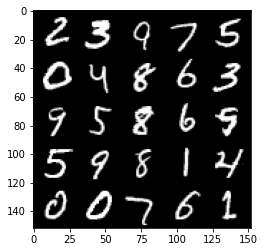

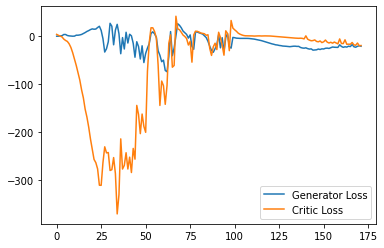

Step 3500: Generator loss: -21.16653005719185, critic loss: -19.041356422424315


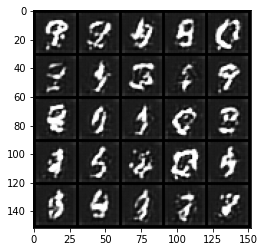

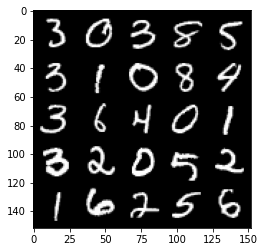

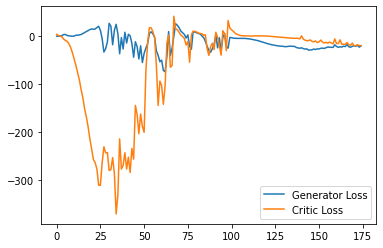

Step 3550: Generator loss: -20.393394575119018, critic loss: -19.47437952041626


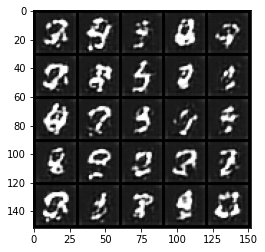

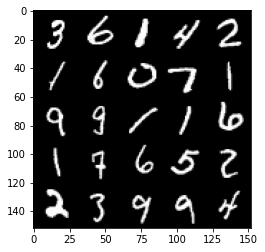

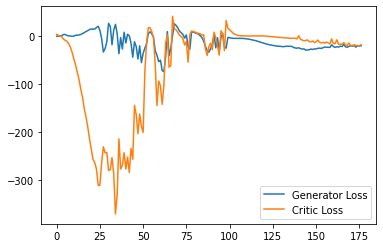

Step 3600: Generator loss: -19.24038028717041, critic loss: -18.196647926330566


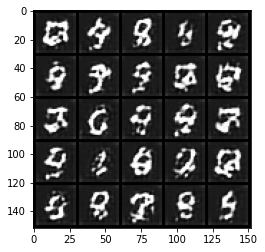

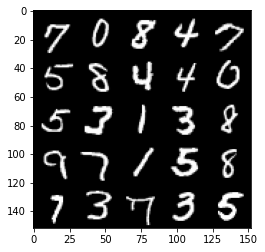

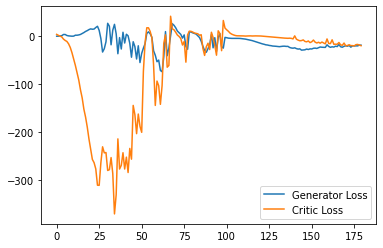

Step 3650: Generator loss: -18.604569835662844, critic loss: -19.429787092208862


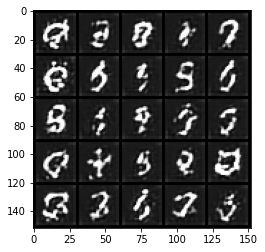

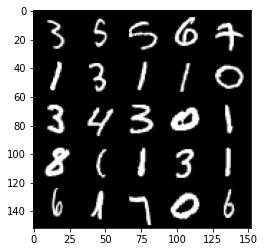

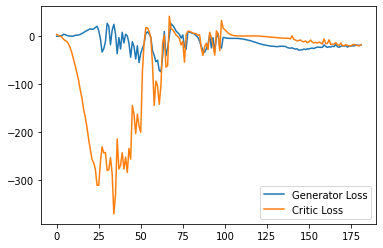

Step 3700: Generator loss: -12.324749813079833, critic loss: -7.450000683307647


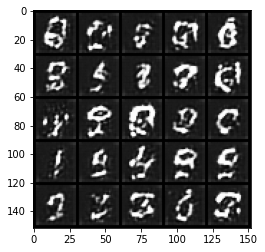

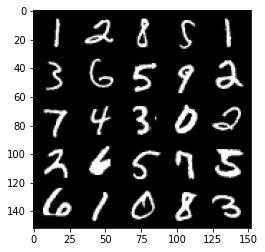

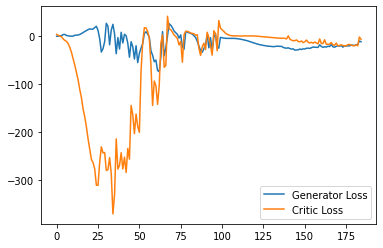

Step 3750: Generator loss: -19.023140417933465, critic loss: -18.680945431709286


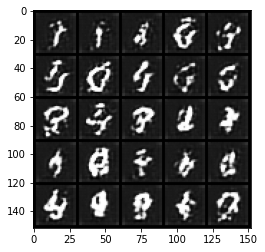

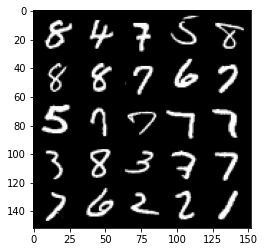

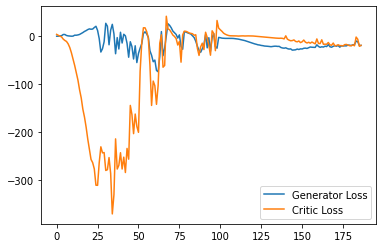

Step 3800: Generator loss: -15.232379703521728, critic loss: -13.96177404499055


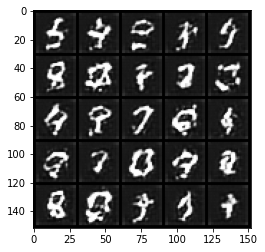

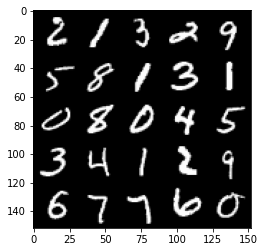

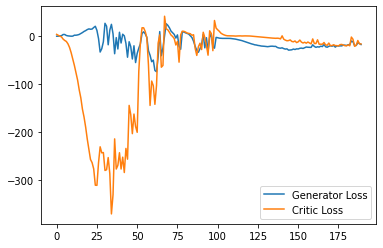

Step 3850: Generator loss: -15.81218913078308, critic loss: -17.853667530059816


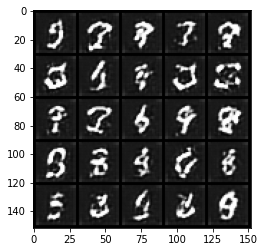

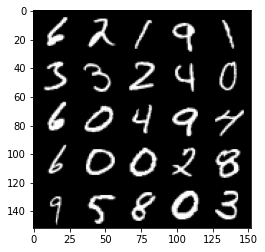

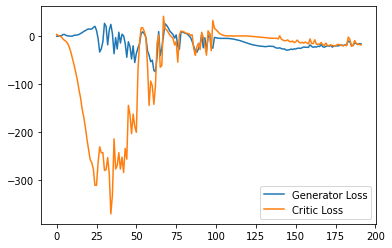

Step 3900: Generator loss: -13.43727624490857, critic loss: -20.38174391174316


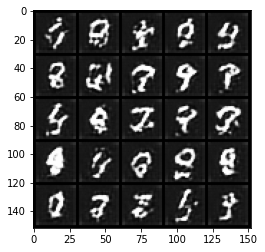

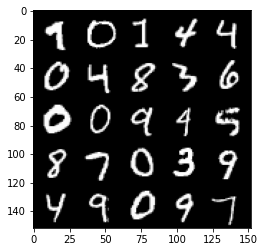

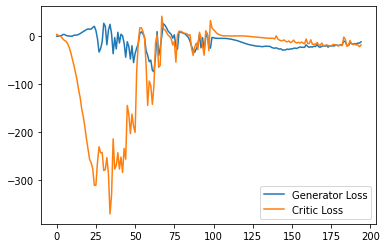

Step 3950: Generator loss: -11.802272824048996, critic loss: -19.985170914649963


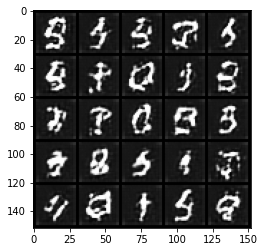

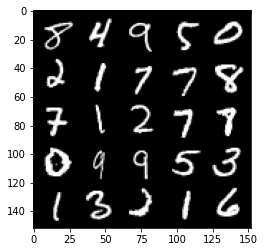

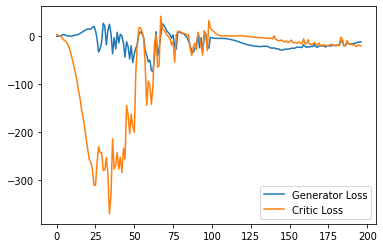

Step 4000: Generator loss: -3.4168656730651854, critic loss: -3.6684924688339233


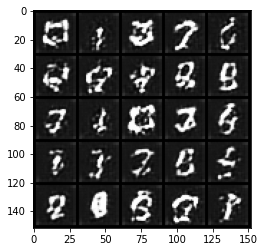

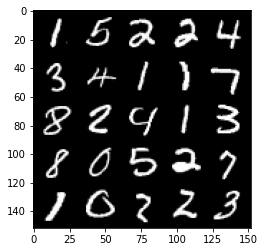

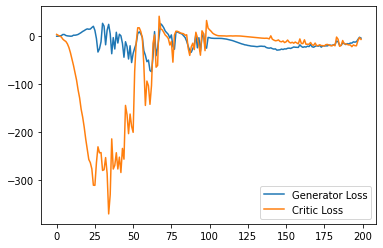

Step 4050: Generator loss: -8.972935195863247, critic loss: -15.138931515693663


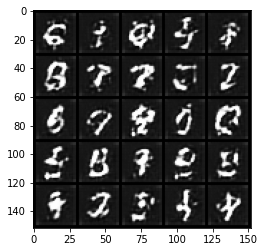

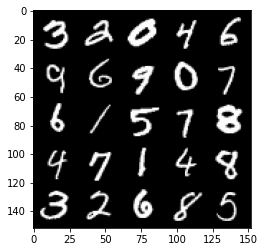

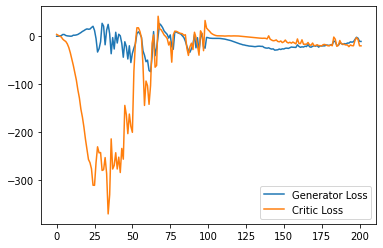

Step 4100: Generator loss: -7.3725627839565275, critic loss: -16.689458870887755


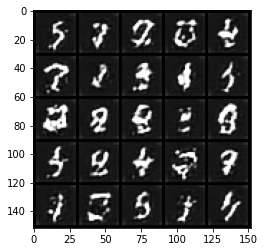

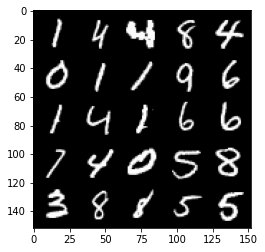

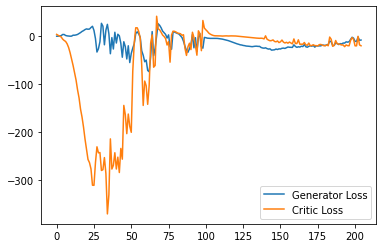

Step 4150: Generator loss: -5.0976529741287235, critic loss: -8.736900071620939


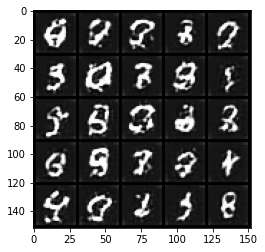

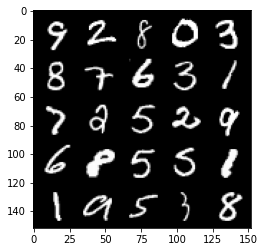

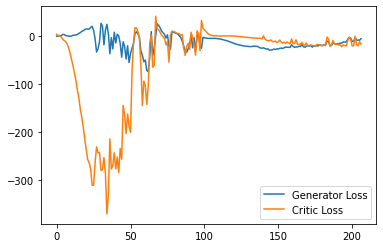

Step 4200: Generator loss: 2.8469502156972886, critic loss: -2.347280889511109


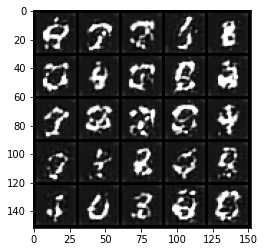

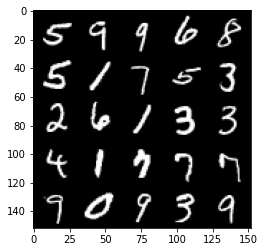

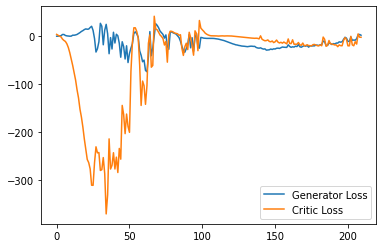

Step 4250: Generator loss: -2.3724528397619724, critic loss: -6.317686031341553


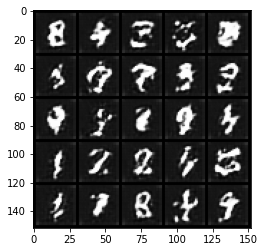

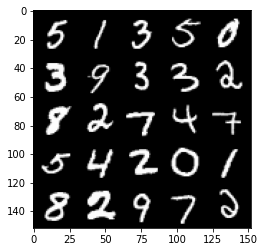

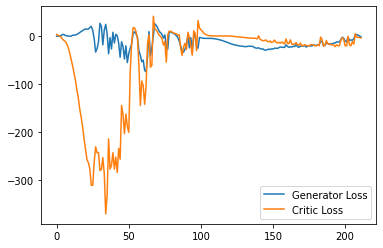

Step 4300: Generator loss: -7.468856768608093, critic loss: -19.84579599952698


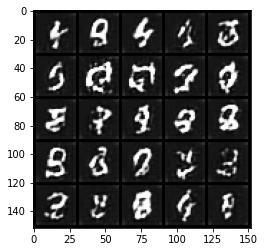

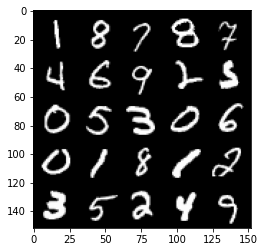

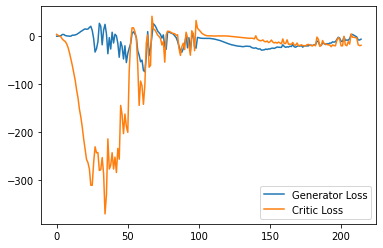

Step 4350: Generator loss: -4.708734391927719, critic loss: -18.66160720348358


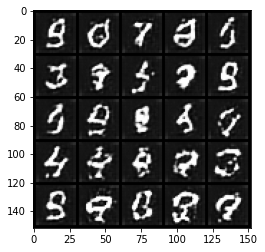

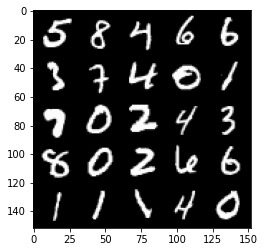

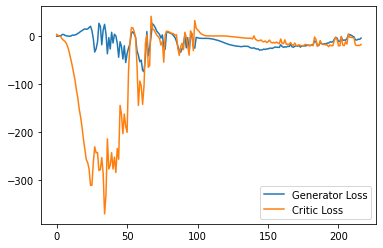

Step 4400: Generator loss: 0.07742476880550385, critic loss: -16.00359607028961


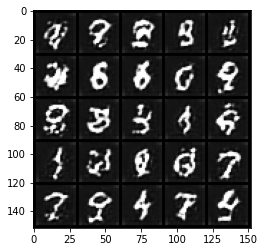

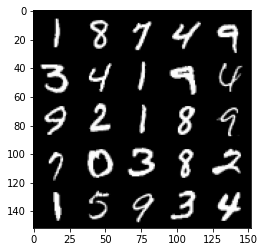

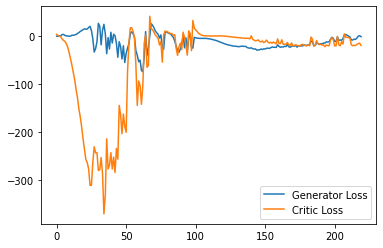

Step 4450: Generator loss: 2.0142698486149313, critic loss: -14.476653579711916


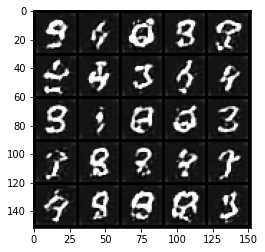

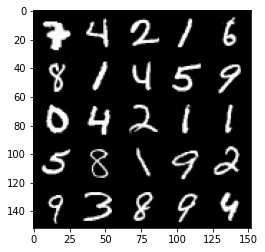

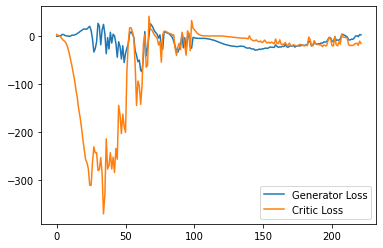

Step 4500: Generator loss: 2.8844281214475633, critic loss: -12.757065097332001


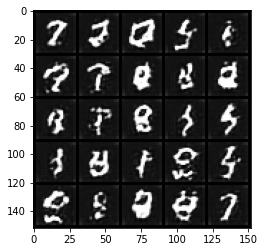

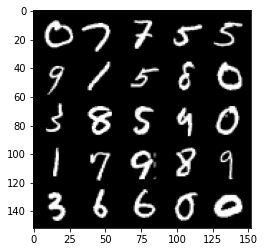

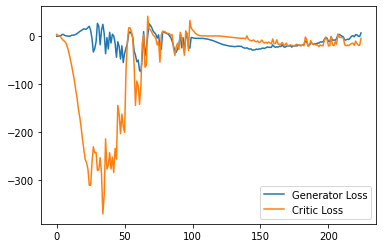

Step 4550: Generator loss: 11.244270782470704, critic loss: -3.5104106016159062


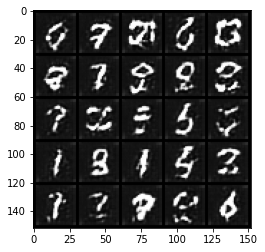

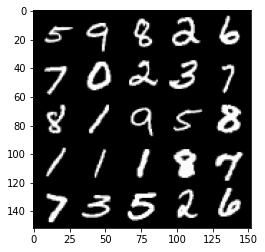

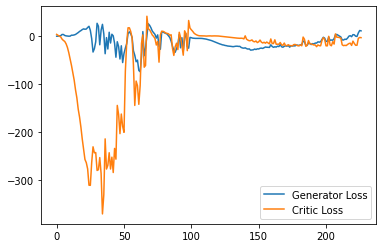

Step 4600: Generator loss: 3.564118163585663, critic loss: -14.257862710475917


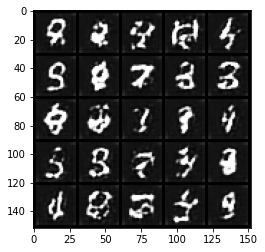

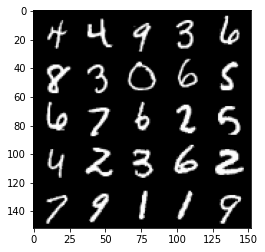

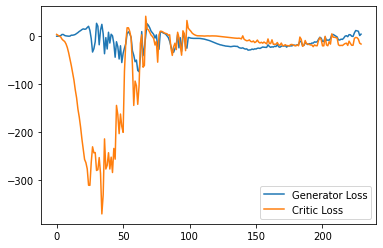

Step 4650: Generator loss: 4.5992146509885785, critic loss: -18.298113879203797


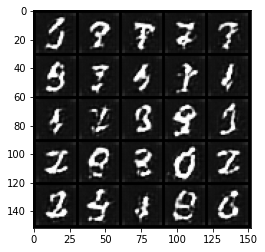

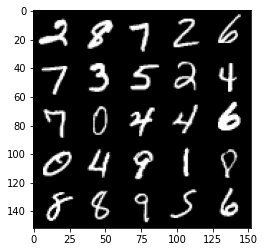

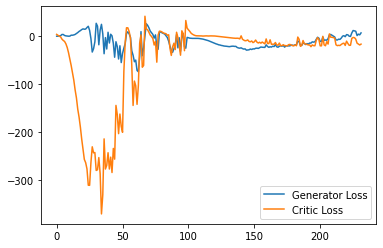

Step 4700: Generator loss: 6.08625181697309, critic loss: -17.031838762283325


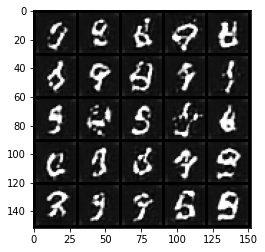

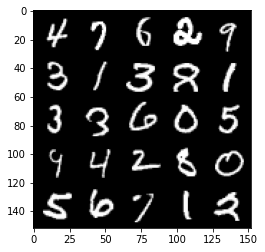

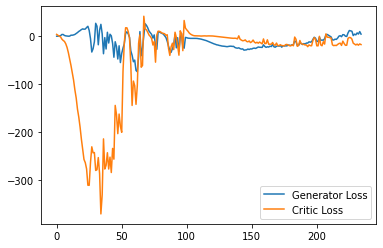

Step 4750: Generator loss: 12.592262179851533, critic loss: -8.073648500442504


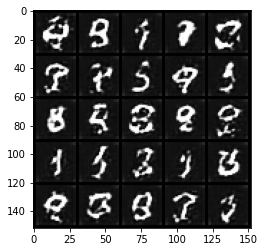

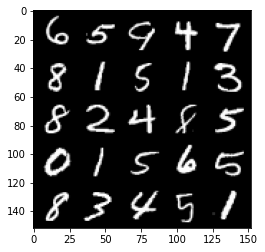

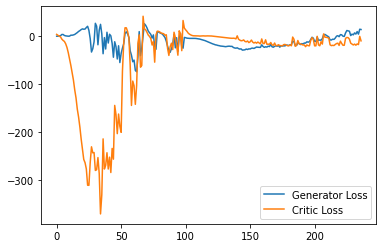

Step 4800: Generator loss: 6.976719069480896, critic loss: -13.60259659957886


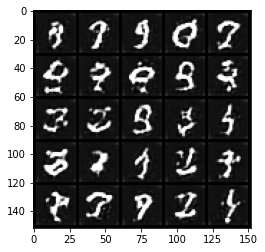

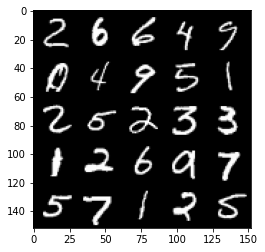

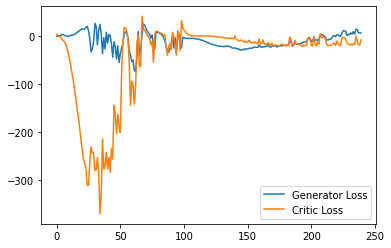

Step 4850: Generator loss: 17.336439533233644, critic loss: -2.595314333438873


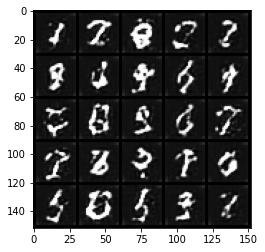

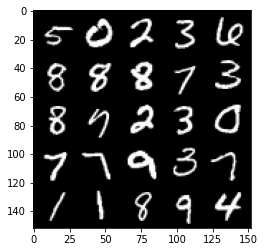

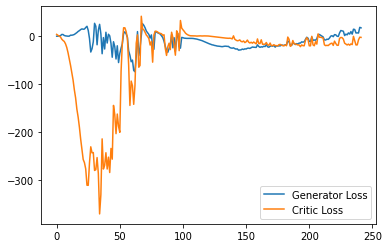

Step 4900: Generator loss: 12.17837649822235, critic loss: -9.31428626537323


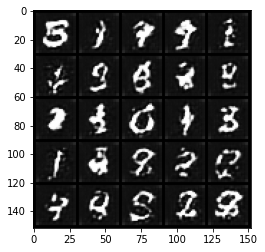

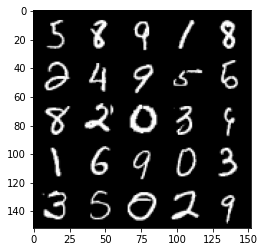

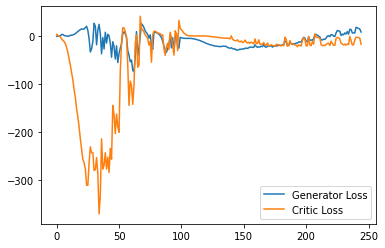

Step 4950: Generator loss: 10.843944900631904, critic loss: -16.725669907569888


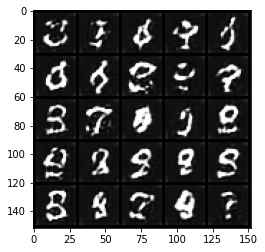

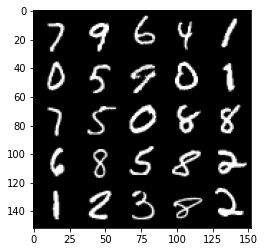

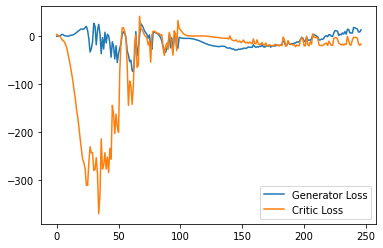

Step 5000: Generator loss: 9.562375299930572, critic loss: -15.326066467761992


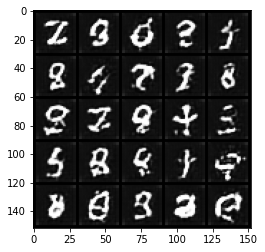

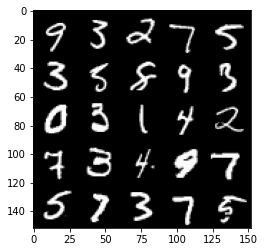

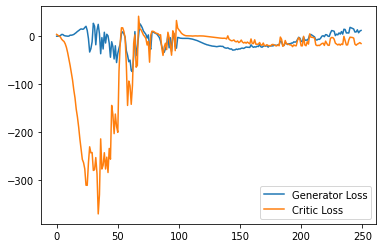

Step 5050: Generator loss: 12.527666459083557, critic loss: -9.229424780368808


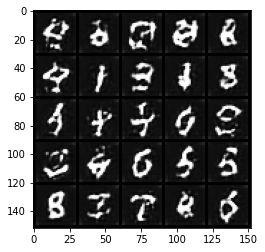

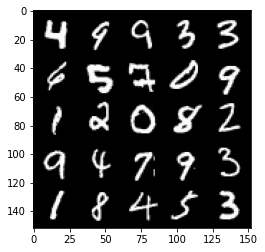

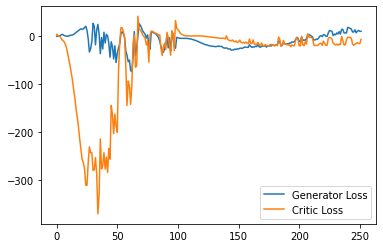

Step 5100: Generator loss: 20.69441150665283, critic loss: -3.1375476570129397


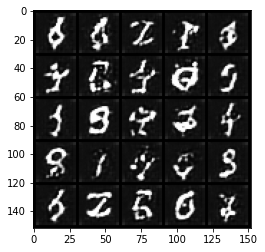

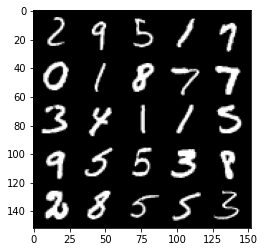

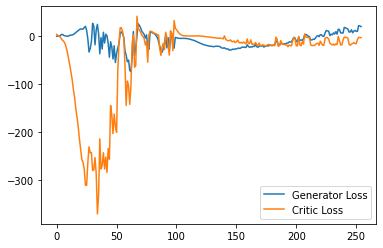

Step 5150: Generator loss: 14.397923512458801, critic loss: -11.543787952899933


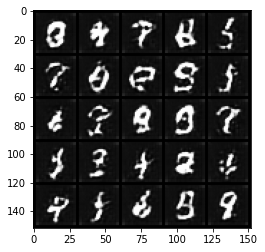

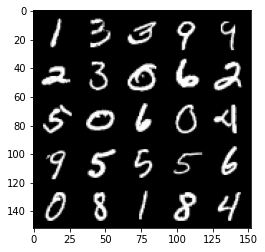

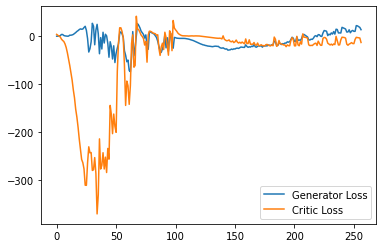

Step 5200: Generator loss: 16.480773544311525, critic loss: -8.213231574535369


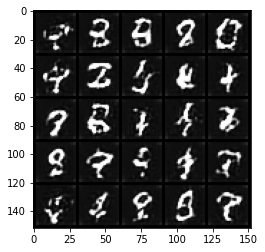

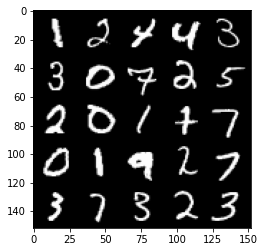

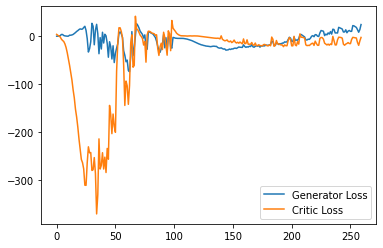

Step 5250: Generator loss: 20.040739669799805, critic loss: -3.6281132640838627


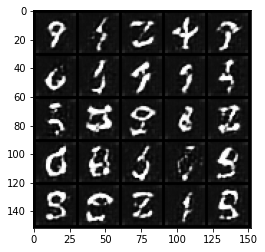

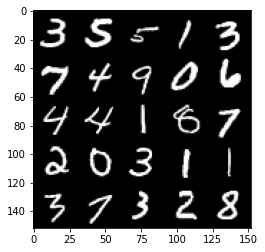

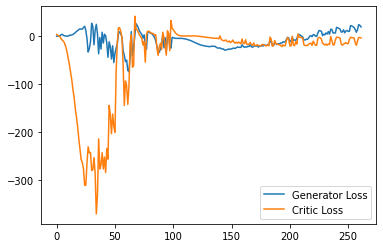

Step 5300: Generator loss: 13.91066267490387, critic loss: -13.209783317565917


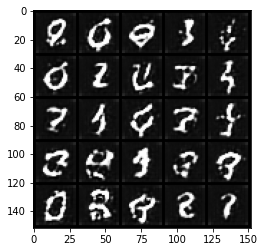

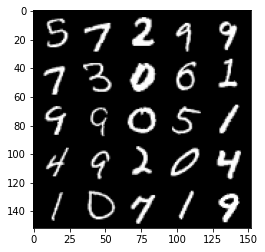

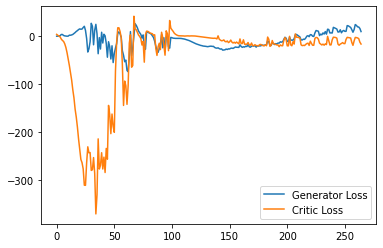

Step 5350: Generator loss: 13.804645223617554, critic loss: -16.553112476825714


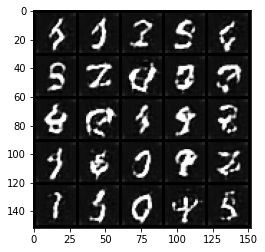

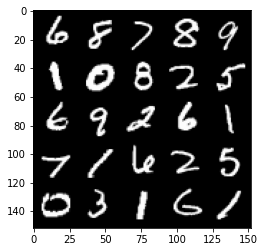

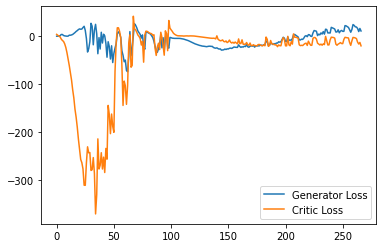

Step 5400: Generator loss: 22.747249298095703, critic loss: 0.9474409725666035


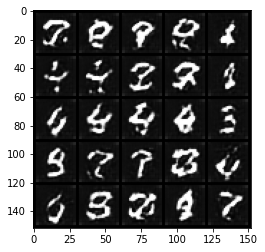

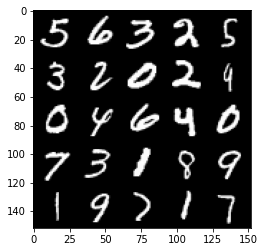

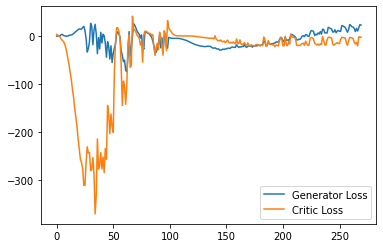

Step 5450: Generator loss: 20.32609874725342, critic loss: -2.4027920103073117


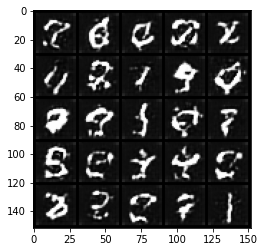

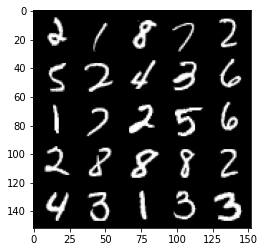

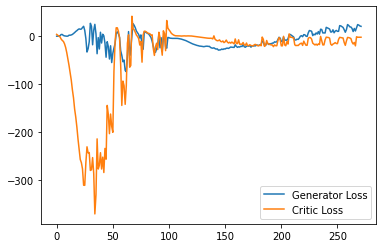

Step 5500: Generator loss: 18.847807579040527, critic loss: -2.8497811422348023


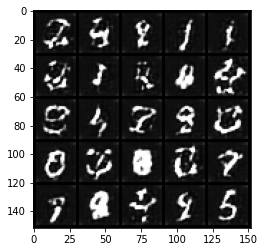

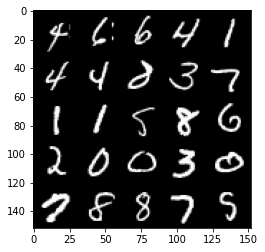

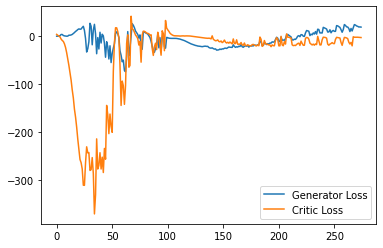

Step 5550: Generator loss: 18.37646800994873, critic loss: -3.286008790016175


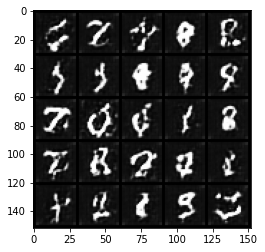

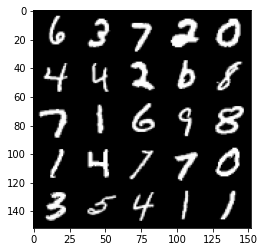

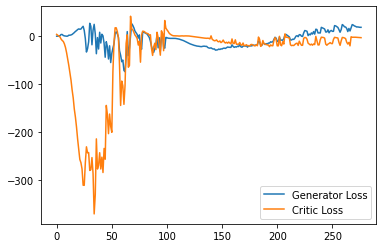

Step 5600: Generator loss: 17.352696704864503, critic loss: -6.132665927410127


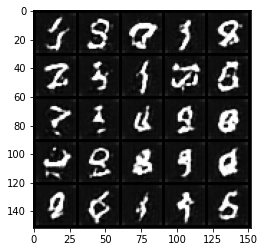

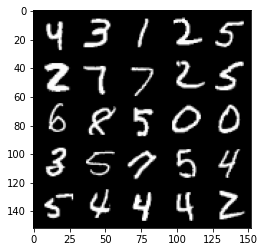

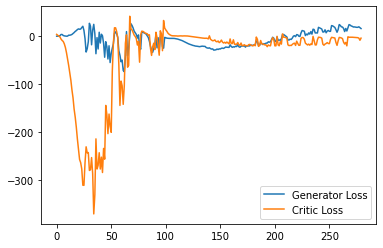

Step 5650: Generator loss: 23.958414306640623, critic loss: -3.3794921350479115


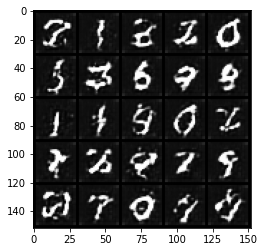

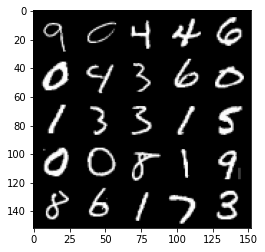

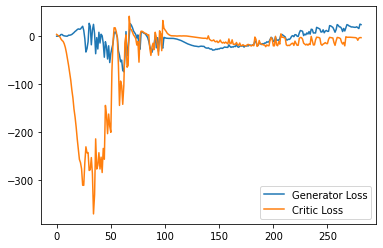

Step 5700: Generator loss: 14.535107641220092, critic loss: -14.32588236713409


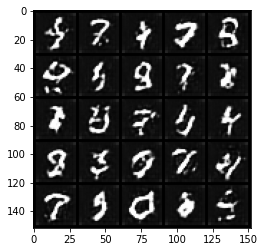

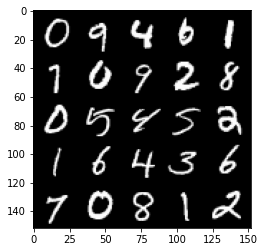

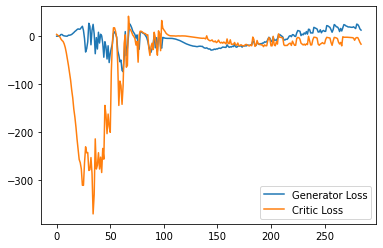

Step 5750: Generator loss: 19.715687141418456, critic loss: -3.5023707184791557


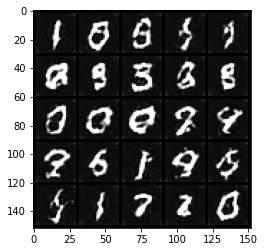

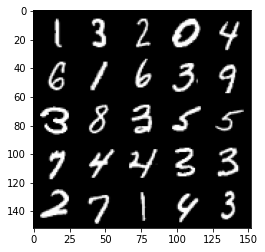

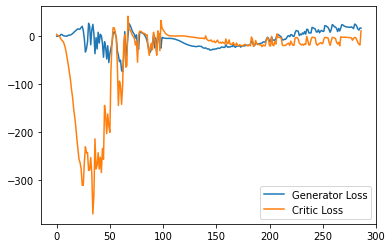

Step 5800: Generator loss: 27.25861587524414, critic loss: -2.0344254364967345


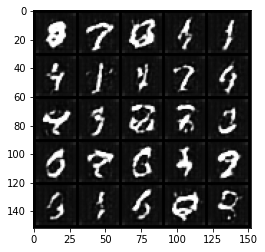

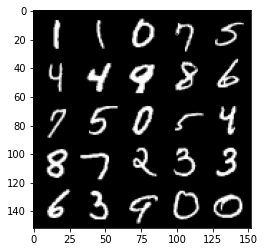

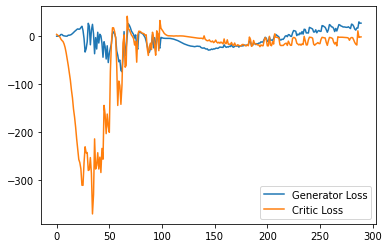

Step 5850: Generator loss: 26.126347732543945, critic loss: -2.4753030800819396


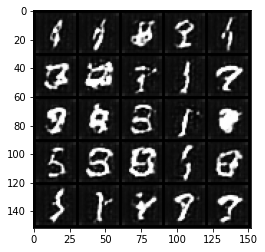

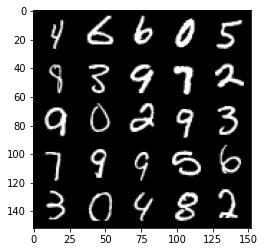

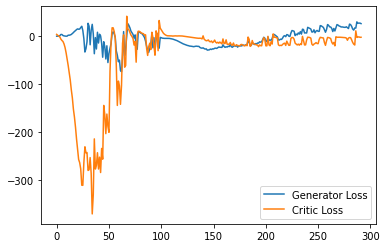

Step 5900: Generator loss: 24.136151695251463, critic loss: -2.5900790071487423


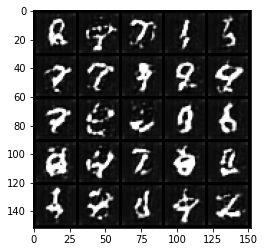

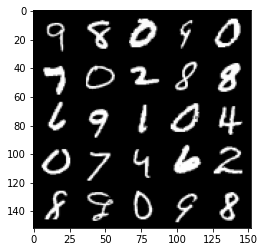

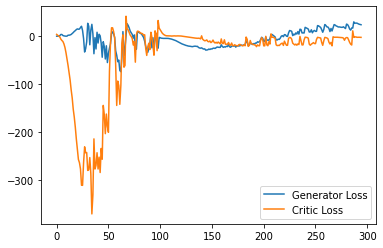

Step 5950: Generator loss: 23.13144245147705, critic loss: -2.947139113426209


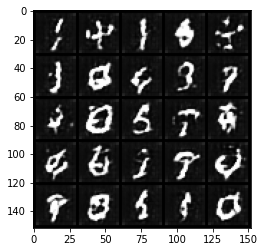

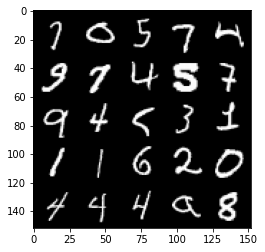

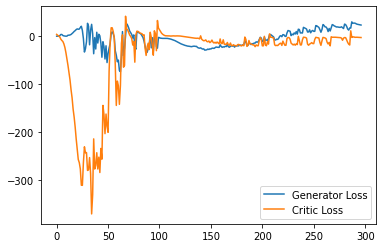

Step 6000: Generator loss: 22.212822761535644, critic loss: -3.3353225035667418


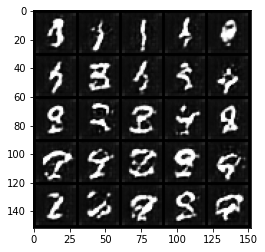

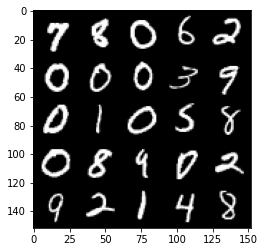

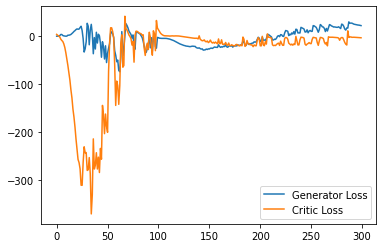

Step 6050: Generator loss: 21.670862464904786, critic loss: -4.391407574653627


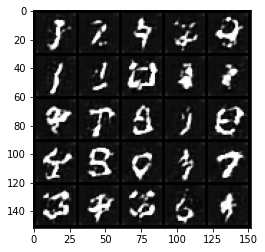

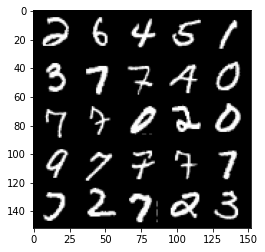

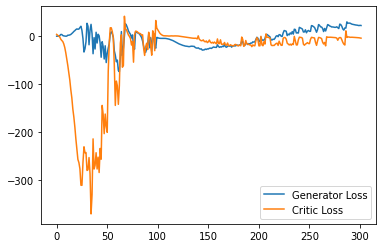

Step 6100: Generator loss: 17.82746082305908, critic loss: -11.65415334510803


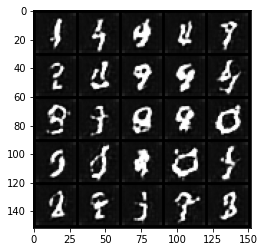

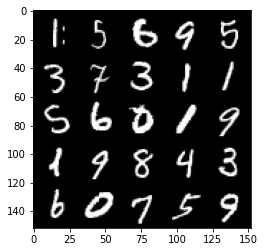

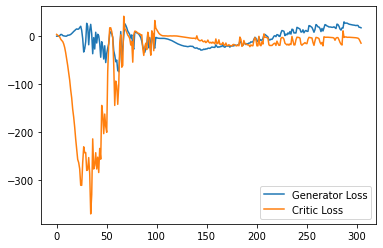

Step 6150: Generator loss: 26.136626014709474, critic loss: -1.108298336029053


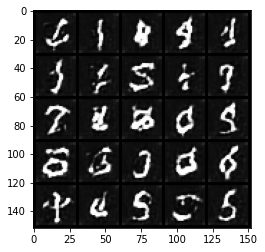

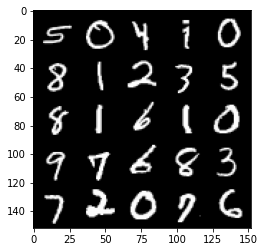

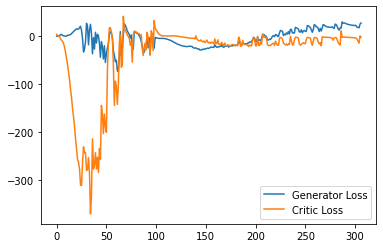

Step 6200: Generator loss: 26.376647605895997, critic loss: -3.0192223472595208


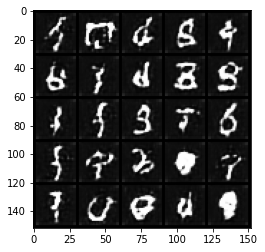

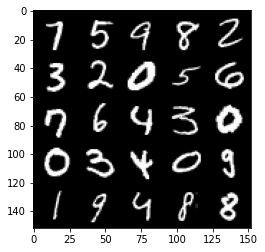

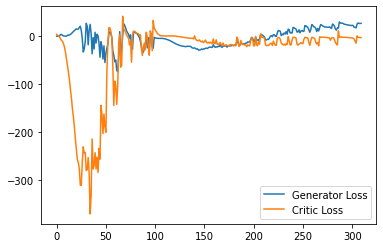

Step 6250: Generator loss: 20.678240489959716, critic loss: -10.432095799446104


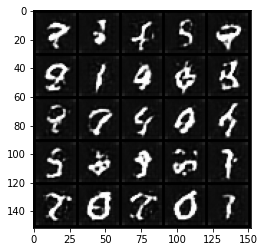

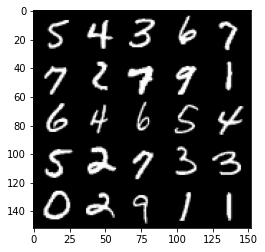

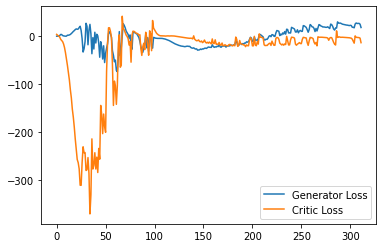

Step 6300: Generator loss: 22.086899013519286, critic loss: -12.157597897768017


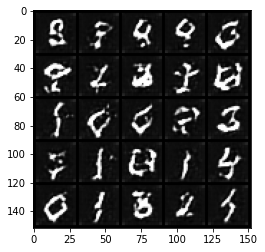

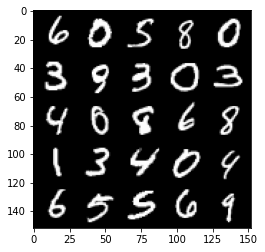

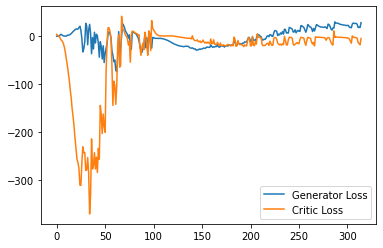

Step 6350: Generator loss: 23.581070461273193, critic loss: -11.40471125507355


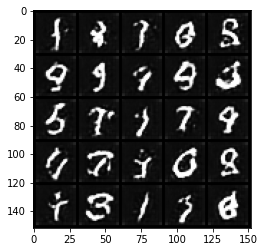

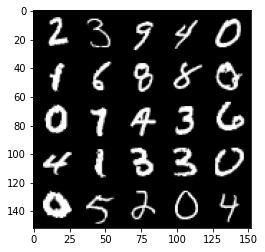

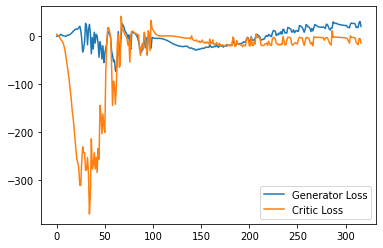

Step 6400: Generator loss: 21.978398094177248, critic loss: -4.505183187961577


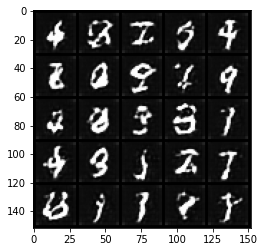

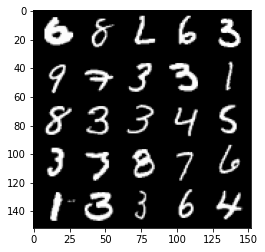

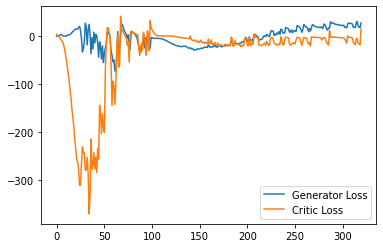

Step 6450: Generator loss: 28.733158378601075, critic loss: -2.3159351853132244


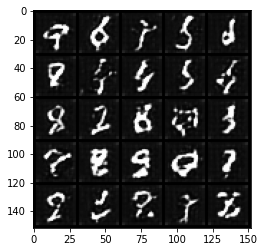

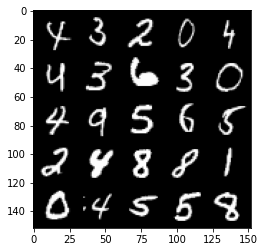

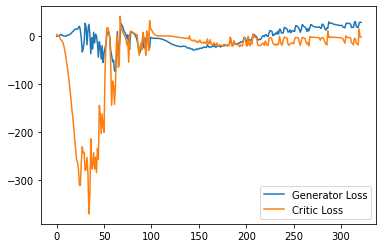

Step 6500: Generator loss: 26.821277503967284, critic loss: -3.035700669765473


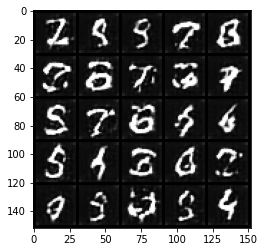

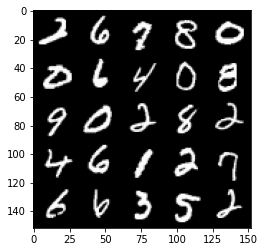

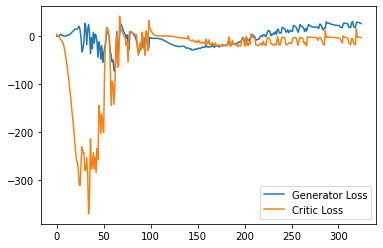

Step 6550: Generator loss: 24.164424057006837, critic loss: -4.320864868164063


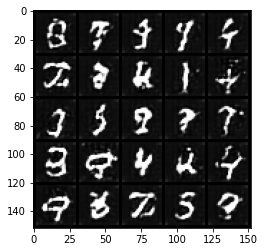

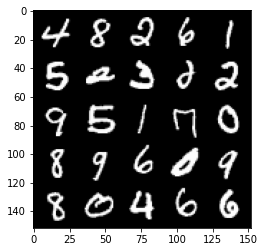

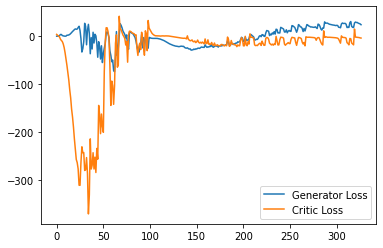

Step 6600: Generator loss: 18.29541721343994, critic loss: -15.155056701660158


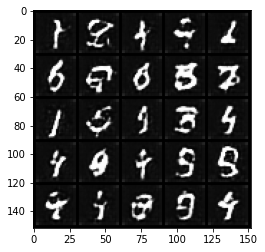

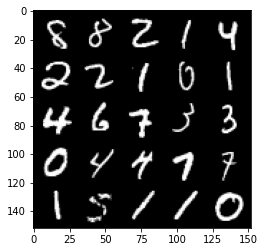

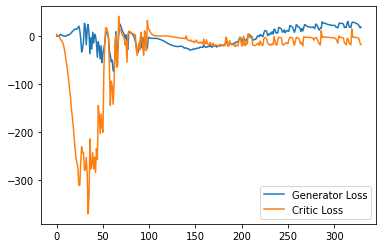

Step 6650: Generator loss: 21.317993869781493, critic loss: -16.475031541824343


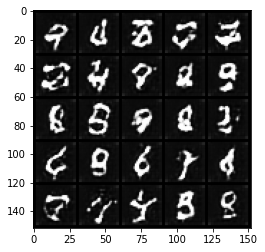

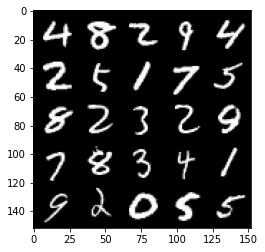

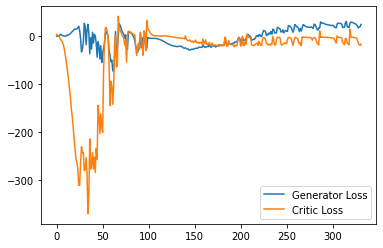

Step 6700: Generator loss: 18.842951622009277, critic loss: -18.036513535022735


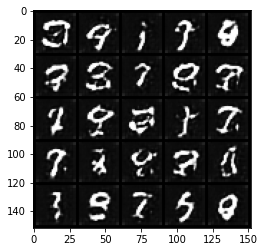

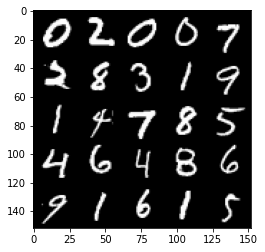

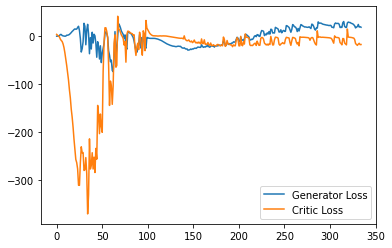

Step 6750: Generator loss: 20.628652572631836, critic loss: -16.390660286903376


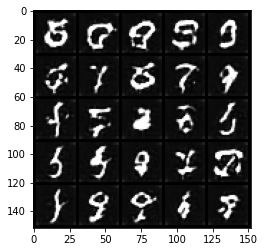

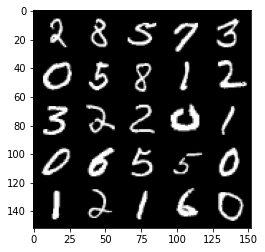

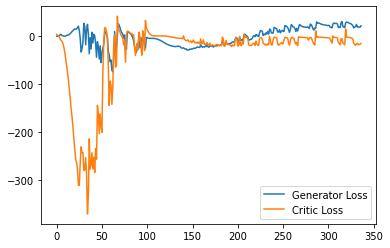

Step 6800: Generator loss: 21.630068168640136, critic loss: -16.80221956825256


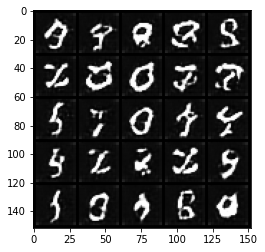

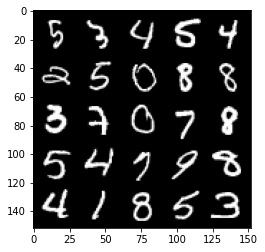

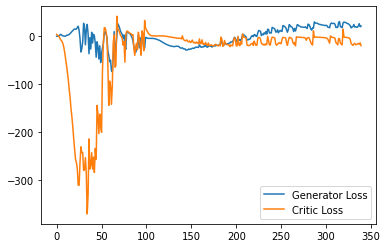

Step 6850: Generator loss: 19.890048599243165, critic loss: -18.851711925506592


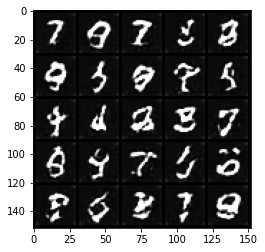

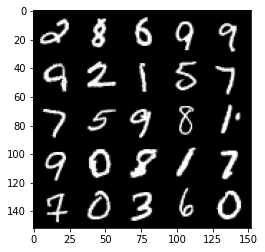

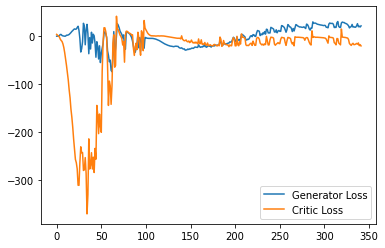

Step 6900: Generator loss: 30.60685494184494, critic loss: -2.8660637292861937


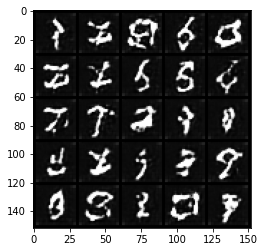

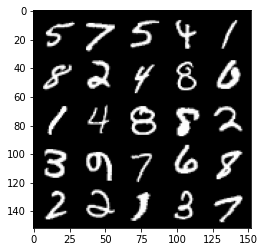

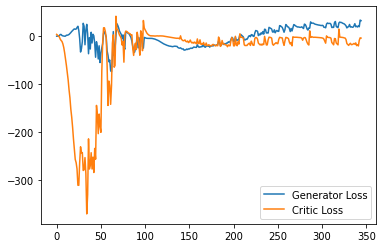

Step 6950: Generator loss: 22.4369104385376, critic loss: -15.042137864589687


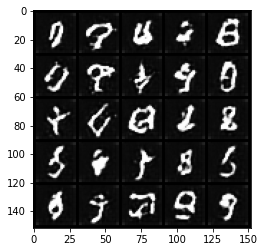

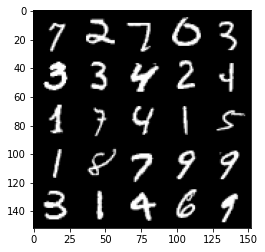

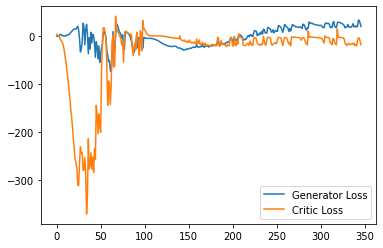

Step 7000: Generator loss: 31.31368965148926, critic loss: 4.817795007705686


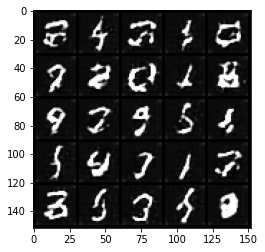

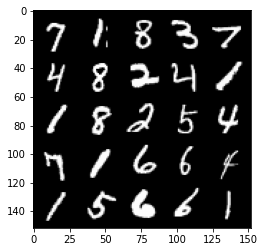

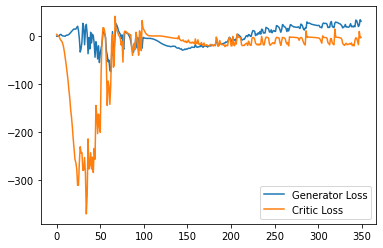

Step 7050: Generator loss: 30.57959445953369, critic loss: -3.6048532404899594


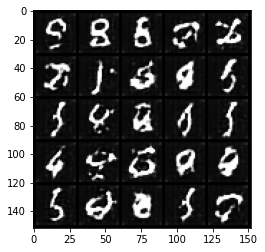

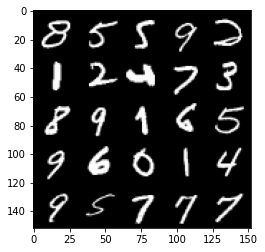

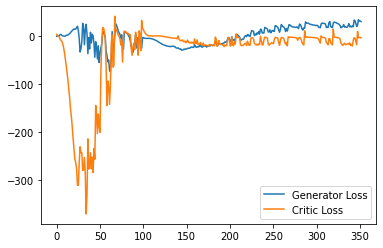

Step 7100: Generator loss: 23.92185506820679, critic loss: -11.462849250316621


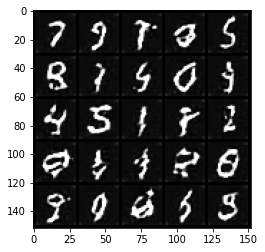

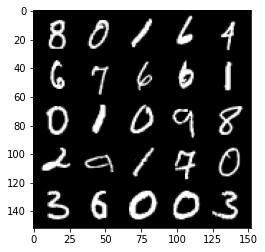

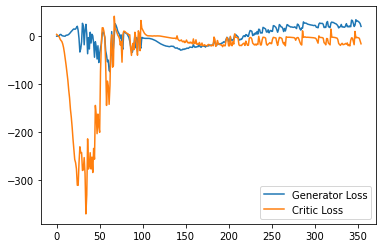

Step 7150: Generator loss: 22.984553661346435, critic loss: -15.209515866756442


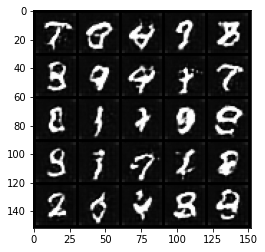

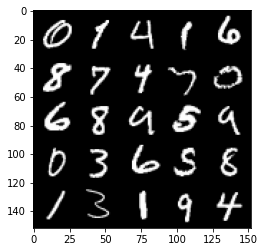

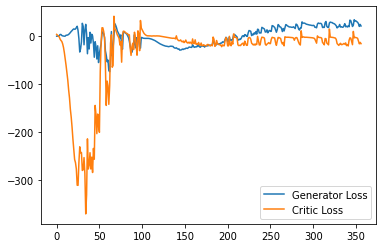

Step 7200: Generator loss: 29.85306583404541, critic loss: -3.66004686498642


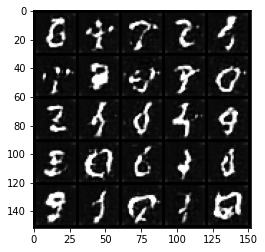

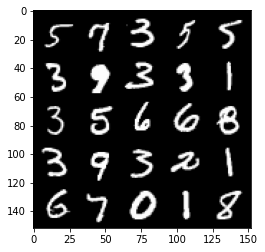

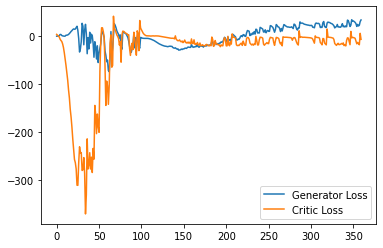

Step 7250: Generator loss: 24.975283966064453, critic loss: -8.820666487693787


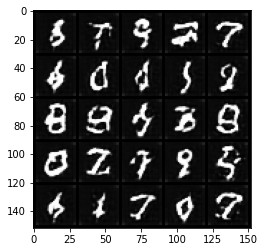

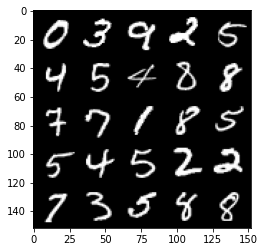

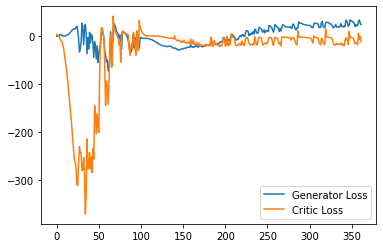

Step 7300: Generator loss: 24.271833457946776, critic loss: -17.6613409512043


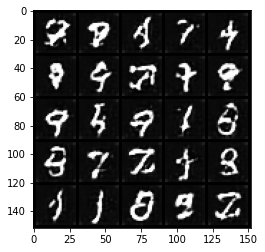

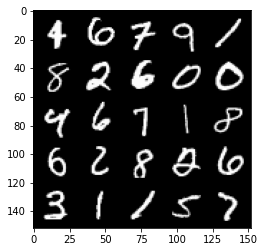

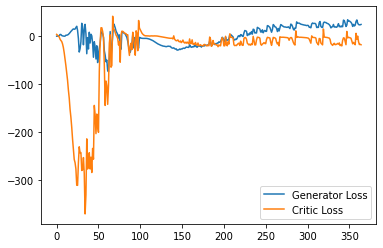

Step 7350: Generator loss: 26.71719108581543, critic loss: -12.419422247886658


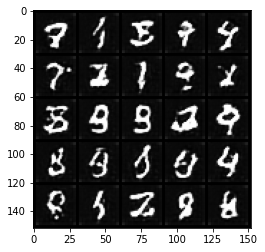

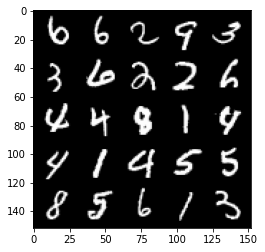

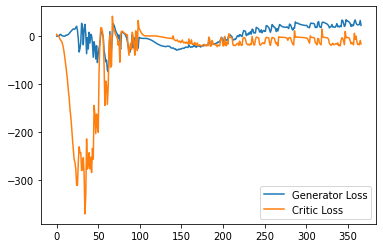

Step 7400: Generator loss: 26.93364604949951, critic loss: -18.782226553678516


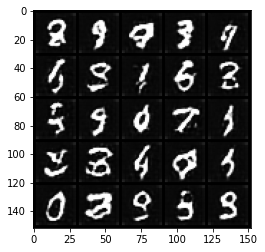

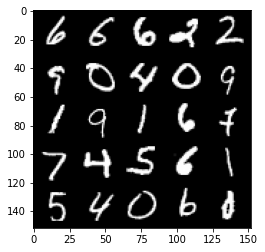

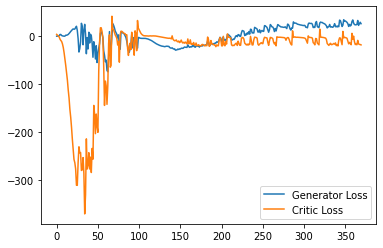

Step 7450: Generator loss: 26.789706840515137, critic loss: -17.805783315658566


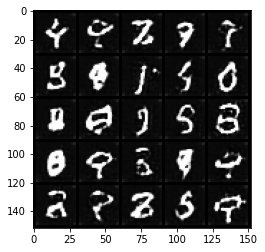

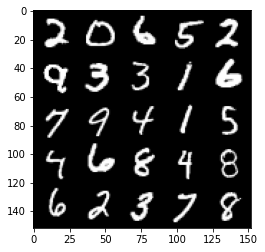

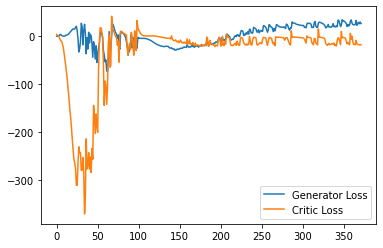

Step 7500: Generator loss: 27.882911338806153, critic loss: -16.051759627580644


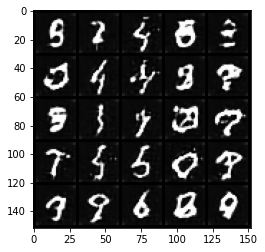

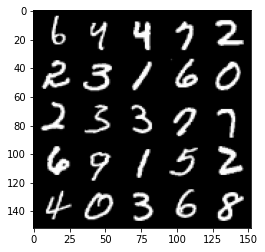

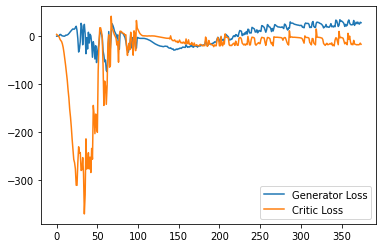

Step 7550: Generator loss: 29.154842453002928, critic loss: -13.20162798166275


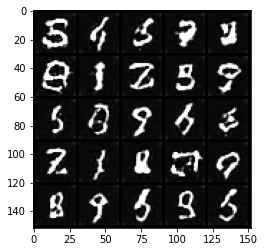

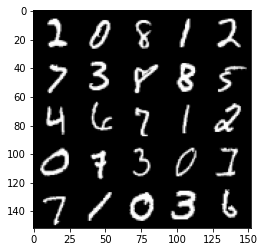

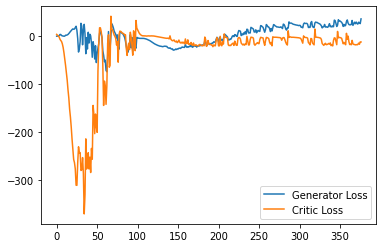

Step 7600: Generator loss: 34.404546966552736, critic loss: -6.946329699516298


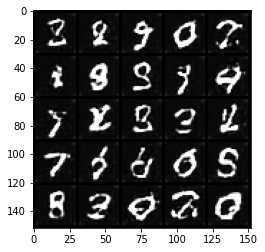

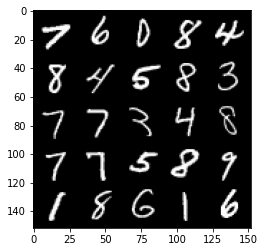

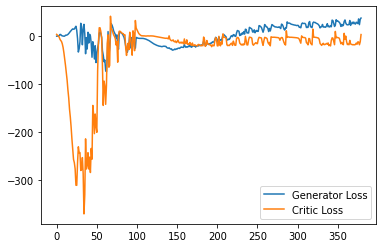

Step 7650: Generator loss: 31.59249954223633, critic loss: -11.986026202201847


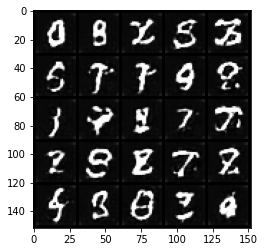

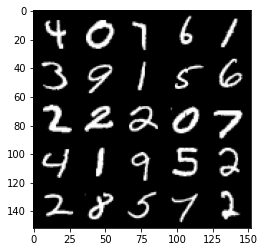

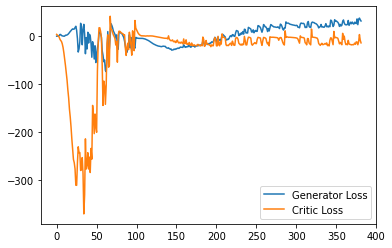

Step 7700: Generator loss: 28.4993151473999, critic loss: -15.696756802082056


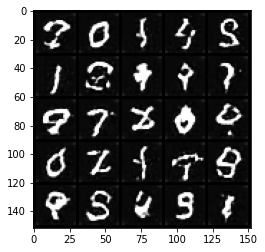

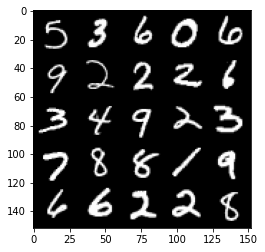

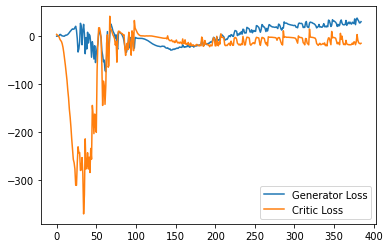

Step 7750: Generator loss: 29.582034034729006, critic loss: -15.809810325622555


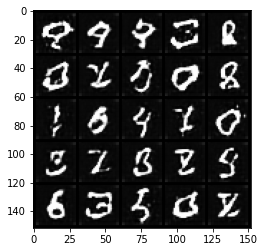

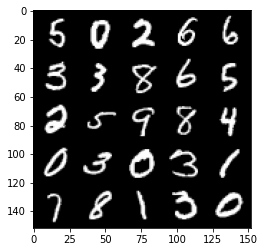

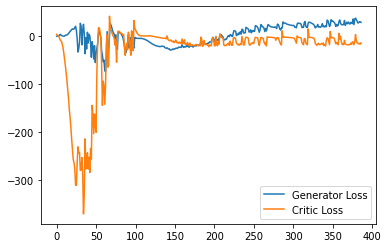

Step 7800: Generator loss: 33.21384811401367, critic loss: -15.601955459356306


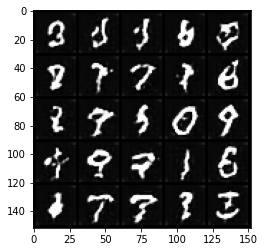

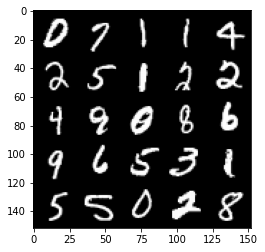

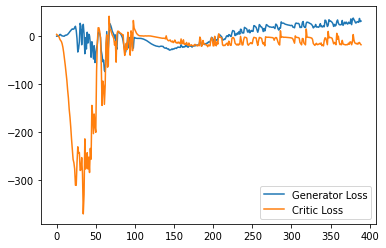

Step 7850: Generator loss: 31.80083339691162, critic loss: -16.48720613527298


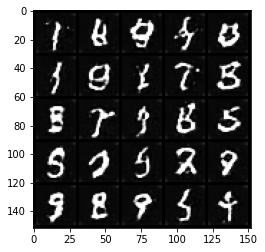

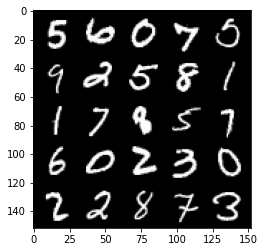

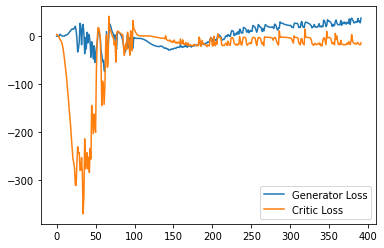

Step 7900: Generator loss: 39.680155220031736, critic loss: -4.044755209445952


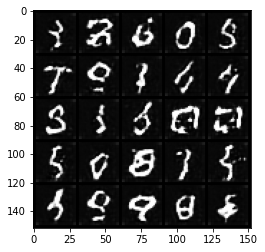

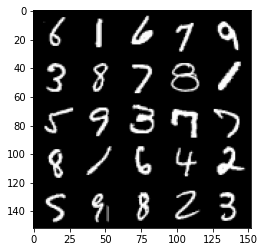

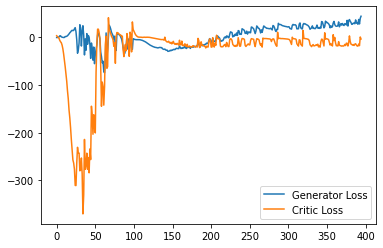

Step 7950: Generator loss: 40.963045806884764, critic loss: -4.486472204208372


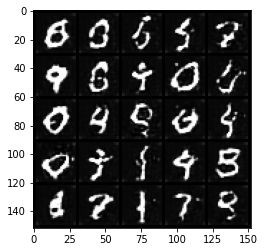

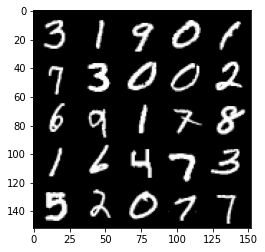

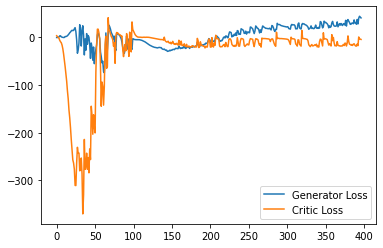

Step 8000: Generator loss: 31.863938789367676, critic loss: -15.51286305141449


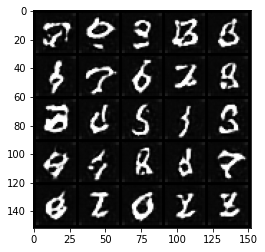

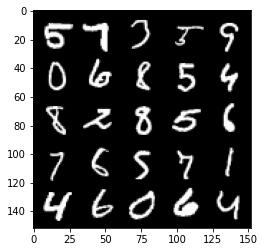

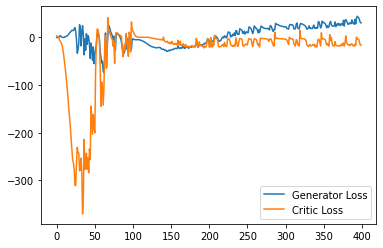

Step 8050: Generator loss: 36.34766315460205, critic loss: -14.523590457439418


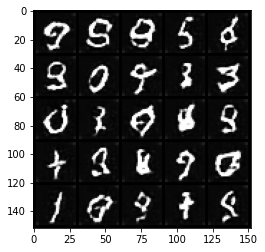

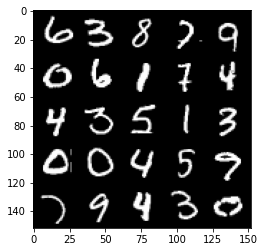

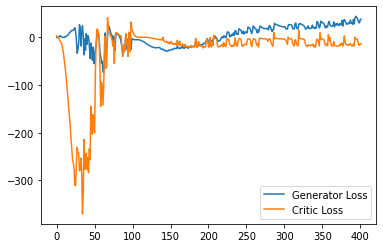

Step 8100: Generator loss: 36.18035732269287, critic loss: -12.489854493618008


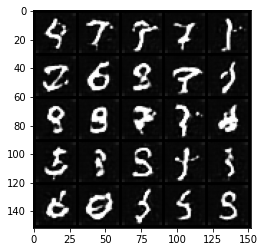

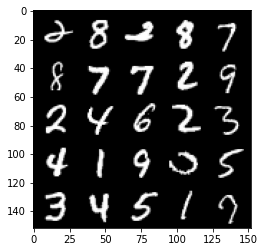

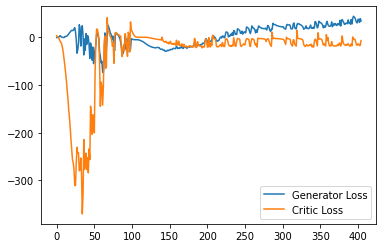

Step 8150: Generator loss: 43.136872100830075, critic loss: -3.813803609848023


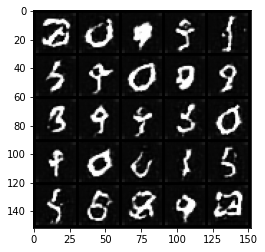

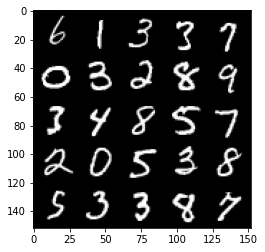

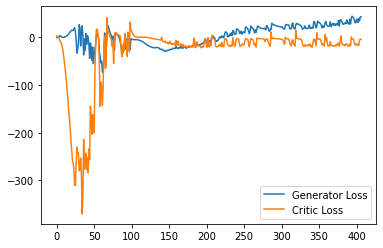

Step 8200: Generator loss: 35.392441253662106, critic loss: -14.723792180061341


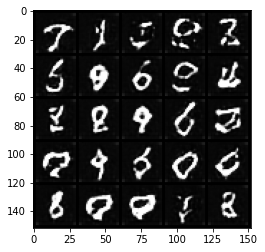

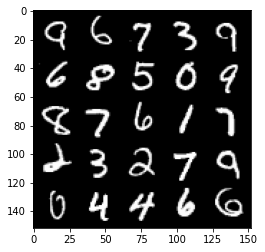

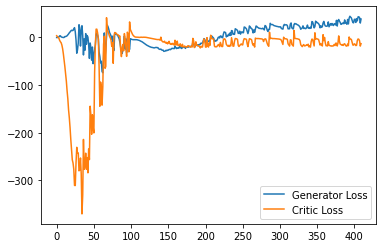

Step 8250: Generator loss: 41.75911808013916, critic loss: -12.652209855794908


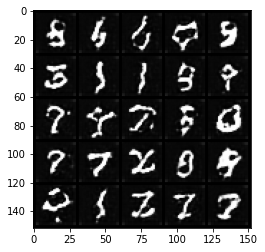

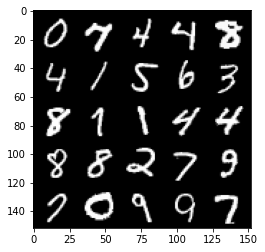

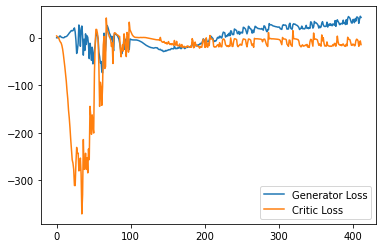

Step 8300: Generator loss: 40.28180950164795, critic loss: -8.751829071998598


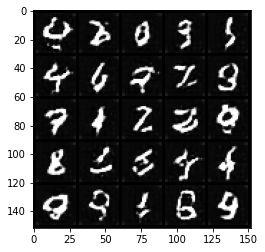

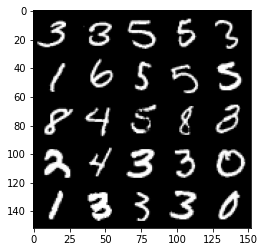

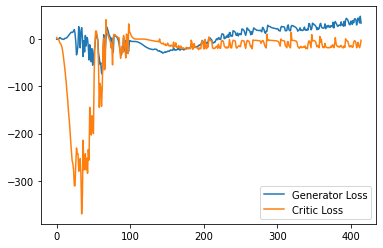

Step 8350: Generator loss: 44.36457332611084, critic loss: -10.819971477746964


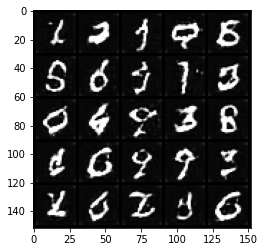

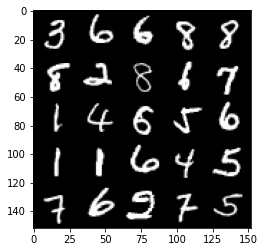

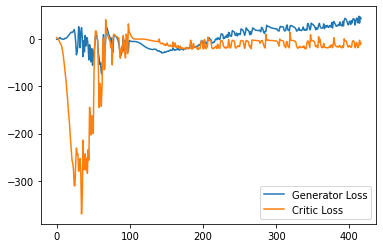

Step 8400: Generator loss: 40.256231422424314, critic loss: -14.397671316146848


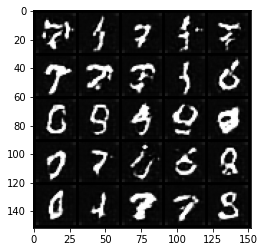

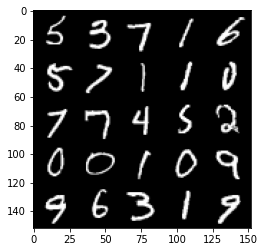

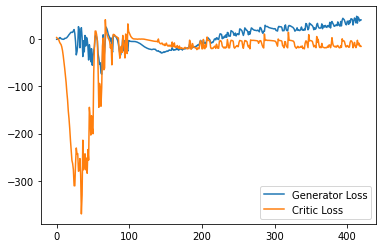

Step 8450: Generator loss: 45.49915336608887, critic loss: -12.730355350494383


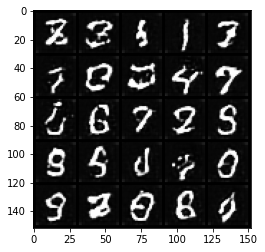

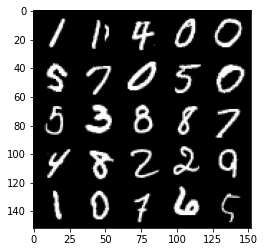

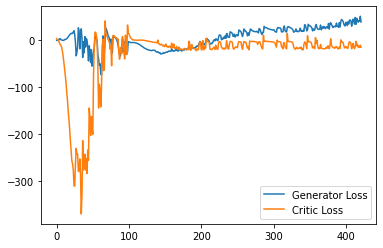

Step 8500: Generator loss: 40.80919570922852, critic loss: -7.943882849693298


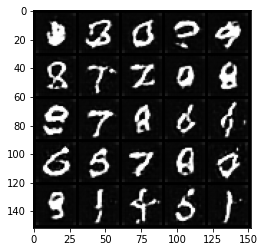

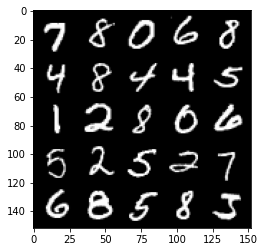

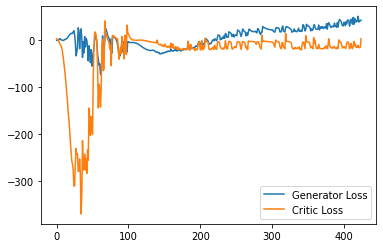

Step 8550: Generator loss: 42.978234100341794, critic loss: -13.59331940174103


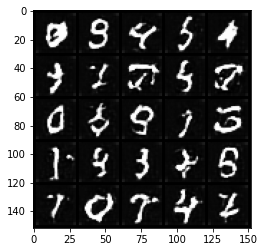

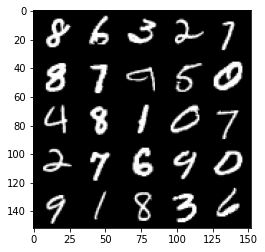

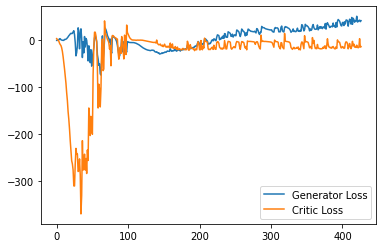

Step 8600: Generator loss: 40.81759338378906, critic loss: -14.429512173175812


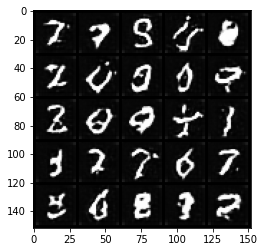

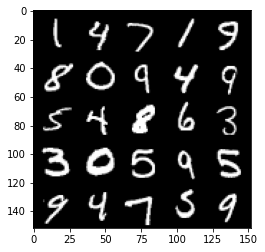

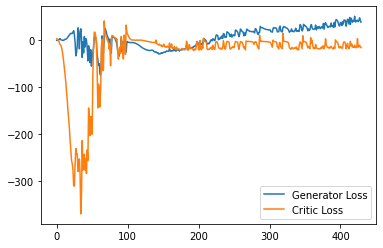

Step 8650: Generator loss: 44.91870807647705, critic loss: -14.347346612215041


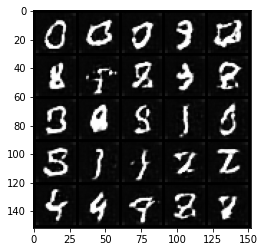

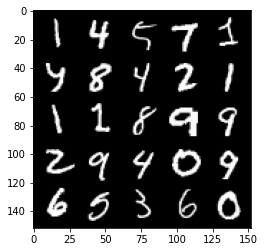

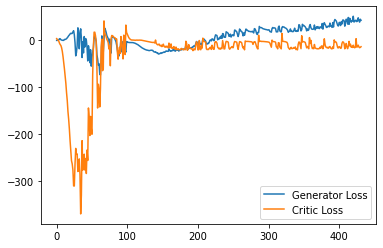

Step 8700: Generator loss: 43.62895057678222, critic loss: -12.696149271011354


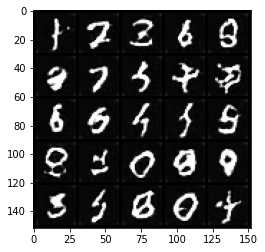

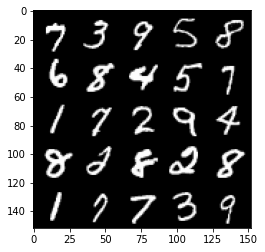

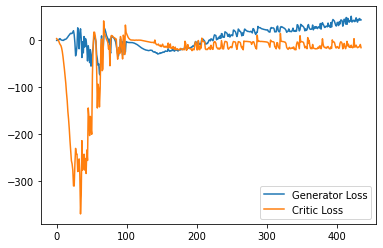

Step 8750: Generator loss: 45.99359764099121, critic loss: -15.003843805074691


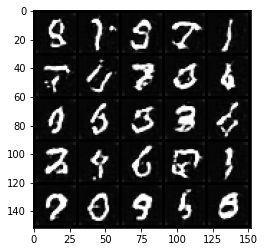

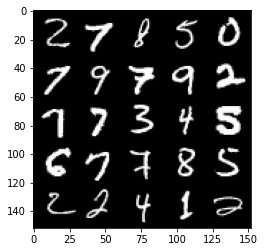

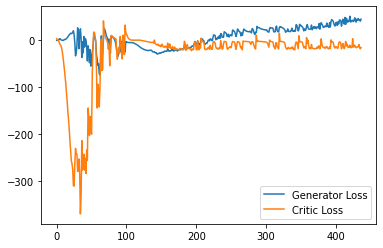

Step 8800: Generator loss: 46.37834156036377, critic loss: -6.062849034070968


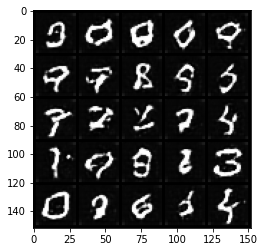

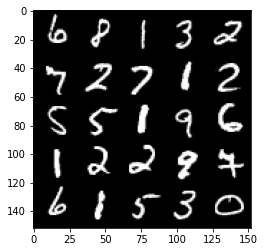

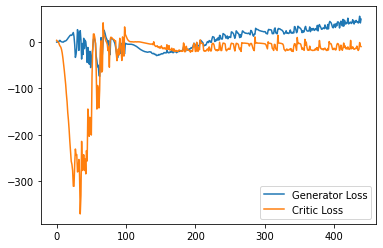

Step 8850: Generator loss: 43.179116325378416, critic loss: -15.43942814898491


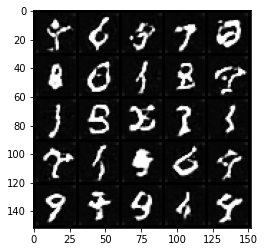

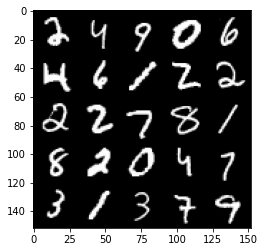

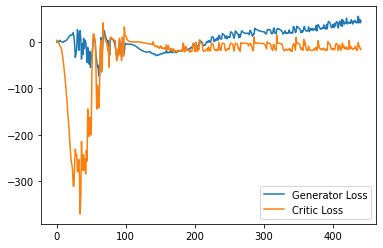

Step 8900: Generator loss: 41.82693386077881, critic loss: -17.242126842498777


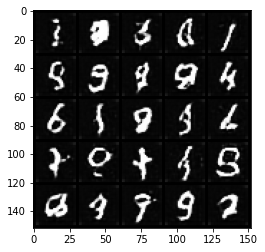

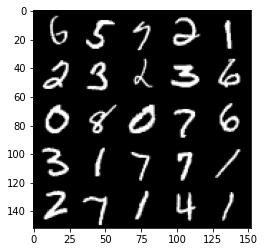

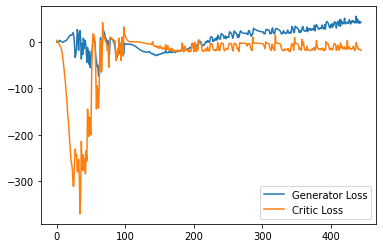

Step 8950: Generator loss: 46.54688041687012, critic loss: -14.54900942611694


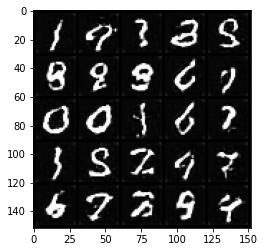

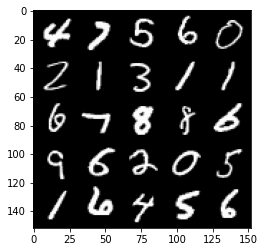

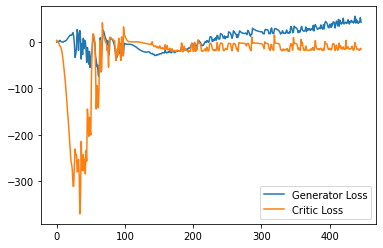

Step 9000: Generator loss: 50.91286384582519, critic loss: -9.647741870880127


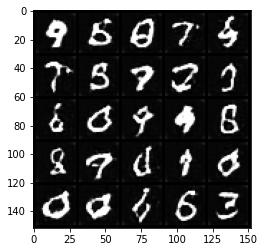

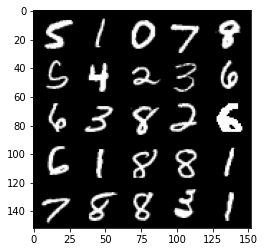

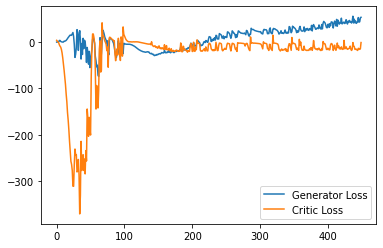

Step 9050: Generator loss: 48.460325927734374, critic loss: -11.633433174371719


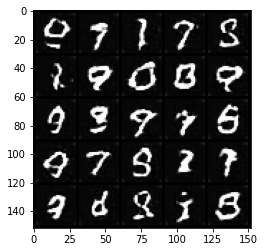

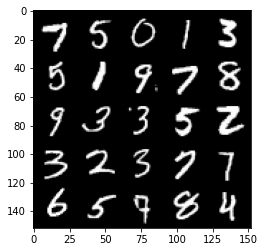

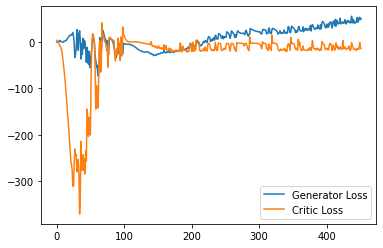

Step 9100: Generator loss: 51.73960067749024, critic loss: -11.673472076892857


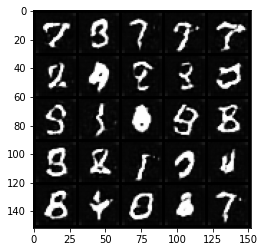

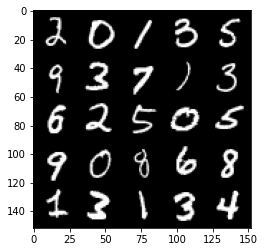

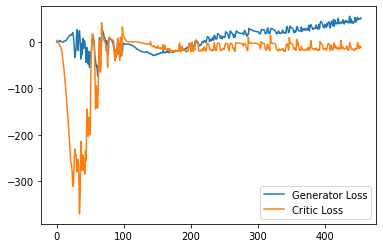

Step 9150: Generator loss: 53.838050842285156, critic loss: -13.01146853876114


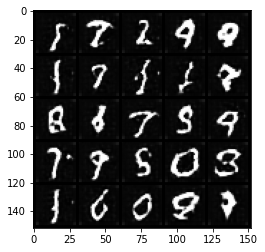

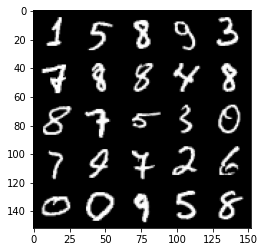

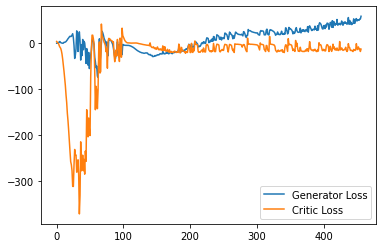

Step 9200: Generator loss: 52.83741493225098, critic loss: -11.505547233581545


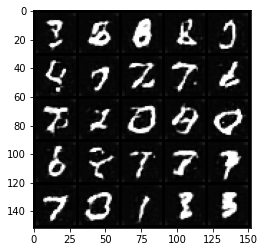

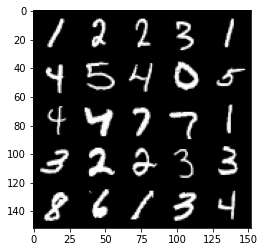

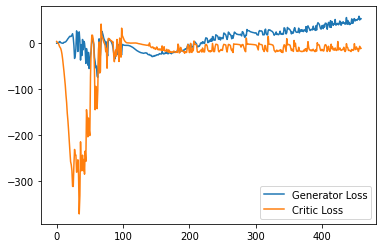

Step 9250: Generator loss: 49.3047607421875, critic loss: -13.02186758160591


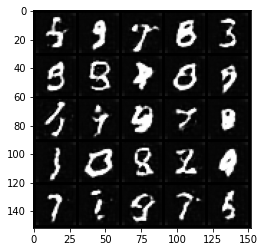

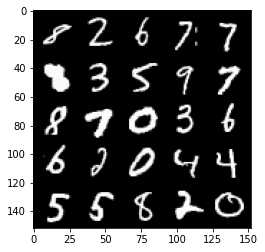

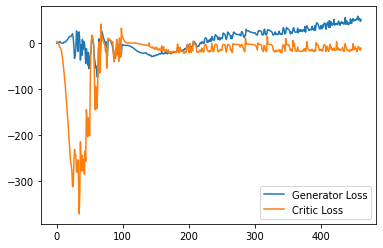

Step 9300: Generator loss: 55.029293594360354, critic loss: -8.86660230350494


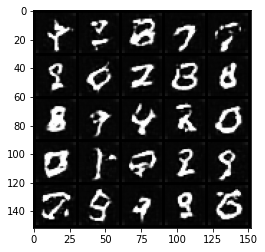

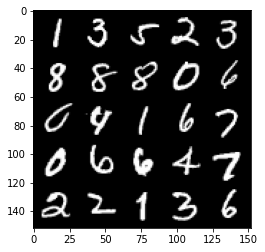

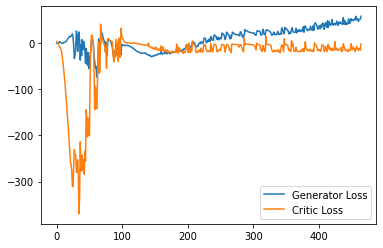

Step 9350: Generator loss: 53.545325927734375, critic loss: -10.16207099723816


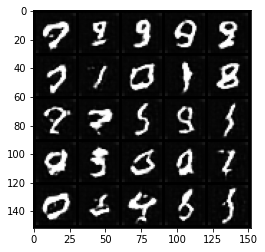

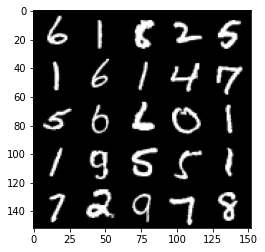

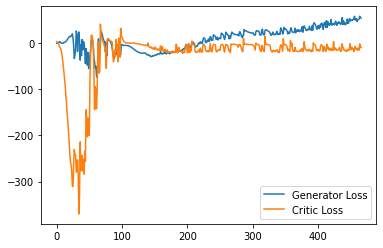

Step 9400: Generator loss: 53.74501205444336, critic loss: -13.248489443778997


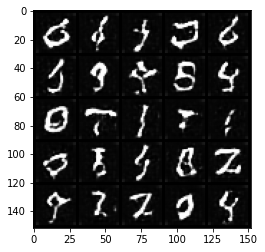

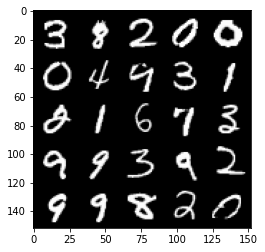

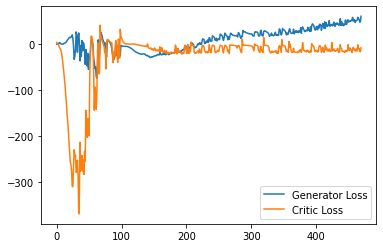

Step 9450: Generator loss: 55.712286224365236, critic loss: -13.801231948852537


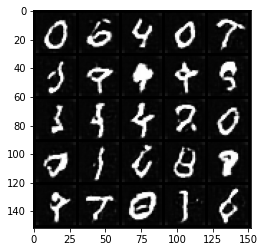

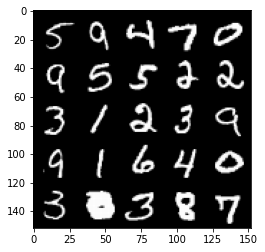

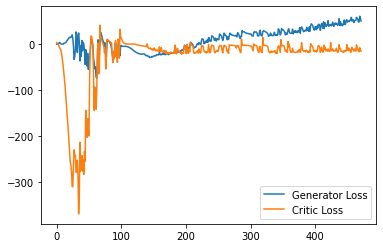

Step 9500: Generator loss: 50.42083976745605, critic loss: -14.300995661497115


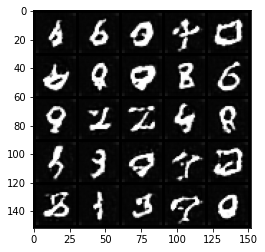

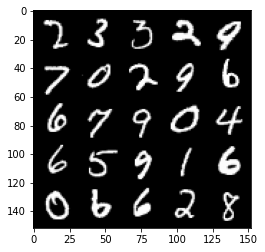

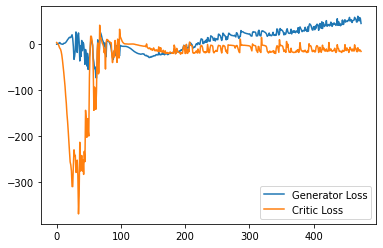

Step 9550: Generator loss: 50.64926780700684, critic loss: -15.318877351045606


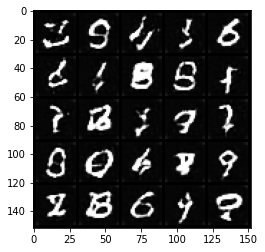

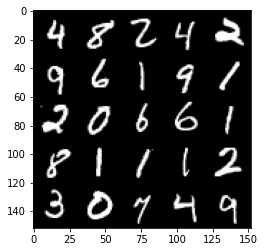

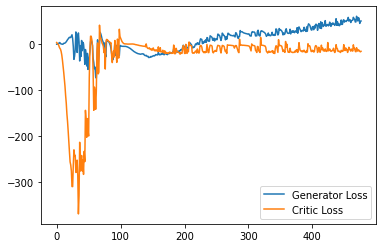

Step 9600: Generator loss: 50.47964309692383, critic loss: -17.68039292049408


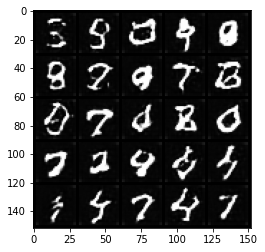

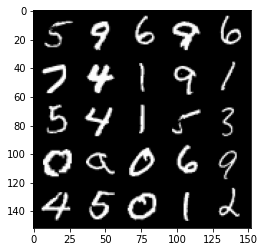

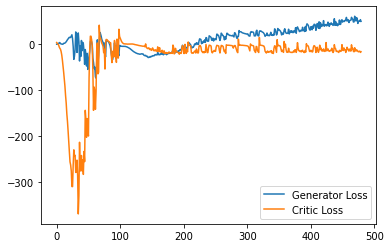

Step 9650: Generator loss: 60.671126708984374, critic loss: -6.635950287342072


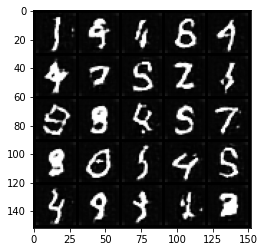

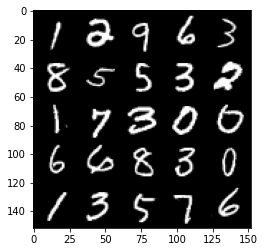

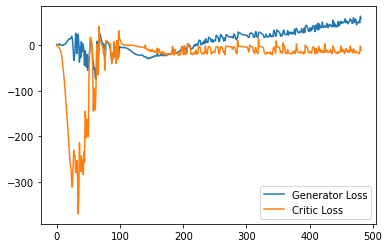

Step 9700: Generator loss: 56.986512985229496, critic loss: -14.361073703527452


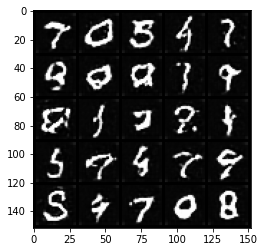

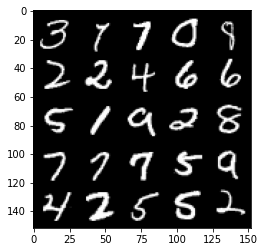

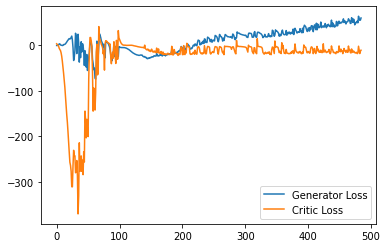

Step 9750: Generator loss: 55.13975395202637, critic loss: -16.69992196321488


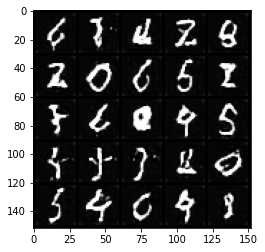

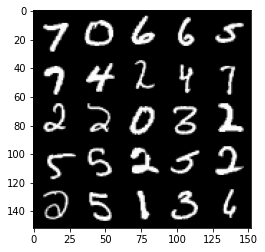

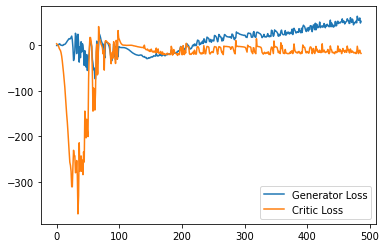

Step 9800: Generator loss: 54.0237419128418, critic loss: -15.502364284992213


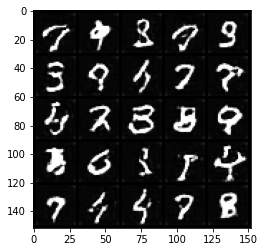

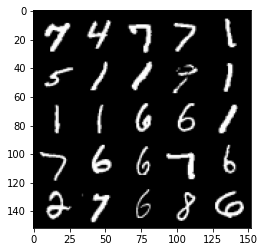

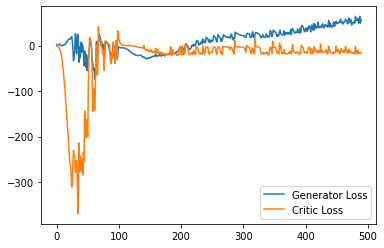

Step 9850: Generator loss: 61.83245162963867, critic loss: -12.132337319374082


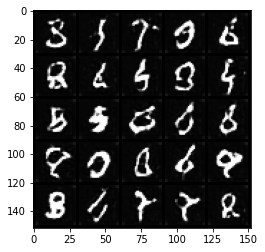

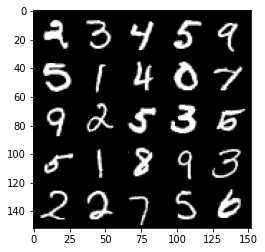

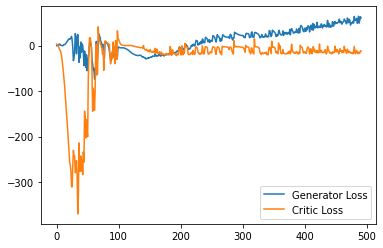

Step 9900: Generator loss: 58.45261161804199, critic loss: -12.291328813076023


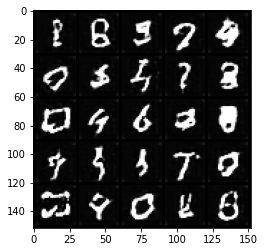

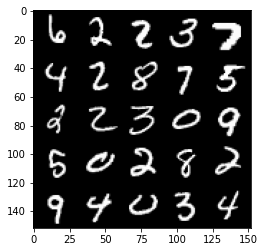

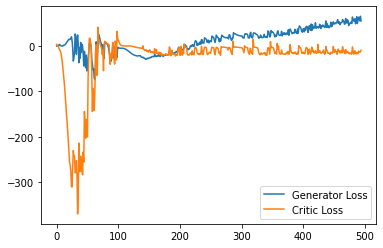

Step 9950: Generator loss: 59.42983573913574, critic loss: -13.69714957761764


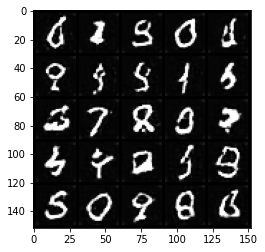

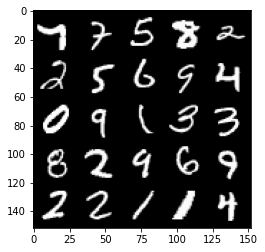

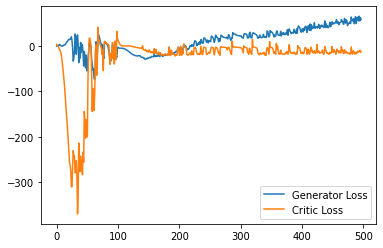

Step 10000: Generator loss: 61.82819631576538, critic loss: 8.233512989997863


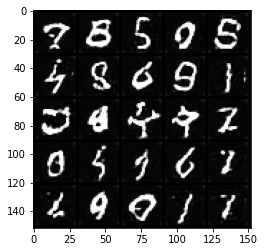

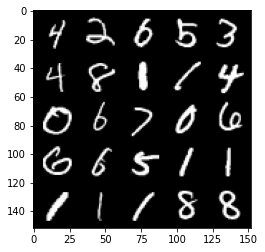

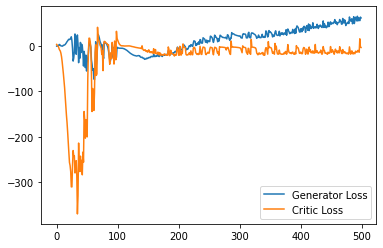

Step 10050: Generator loss: 58.06186241149902, critic loss: -6.668497432231903


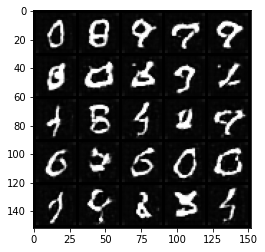

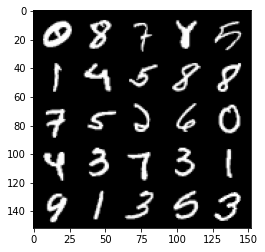

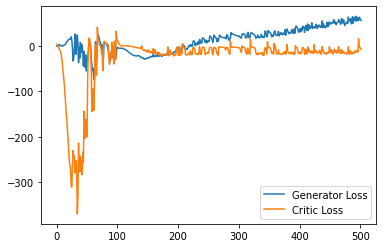

Step 10100: Generator loss: 56.747219467163085, critic loss: -13.892137175679208


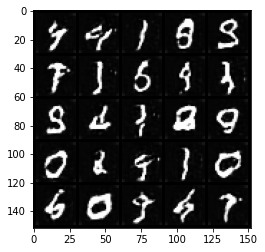

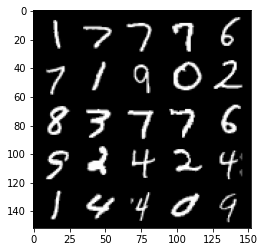

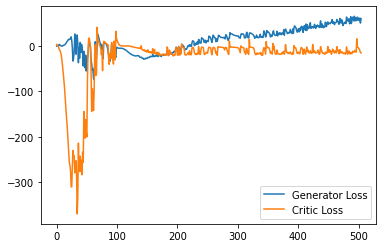

Step 10150: Generator loss: 53.57573837280273, critic loss: -12.400067287445065


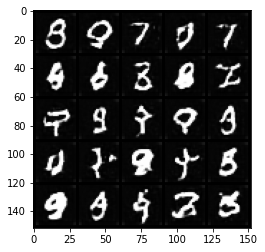

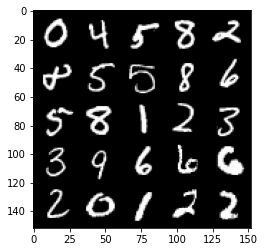

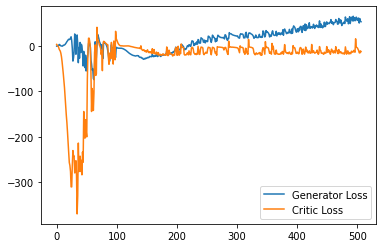

Step 10200: Generator loss: 55.59451126098633, critic loss: -17.5072384428978


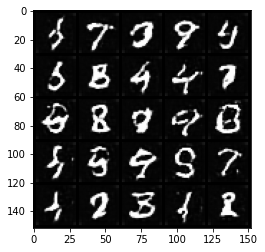

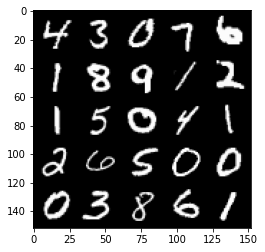

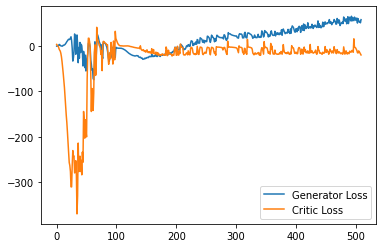

Step 10250: Generator loss: 61.17972389221191, critic loss: -11.94644408798218


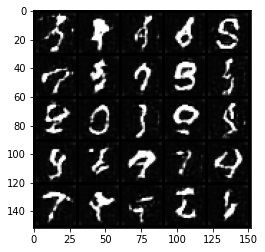

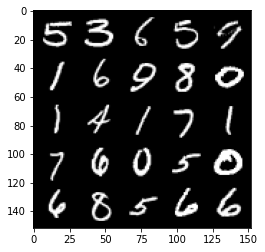

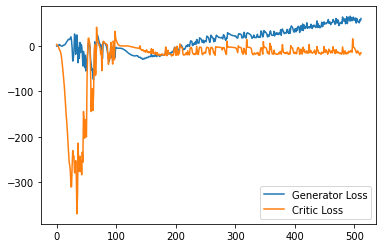

Step 10300: Generator loss: 59.77009941101074, critic loss: -12.202228902339932


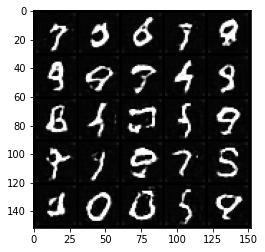

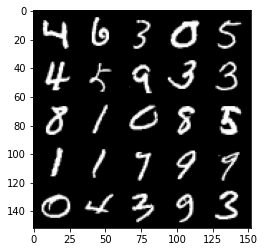

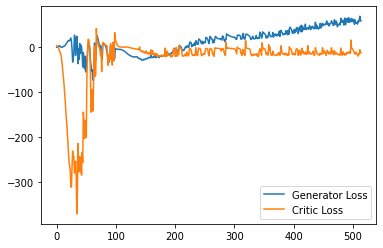

Step 10350: Generator loss: 58.19269172668457, critic loss: -15.706928589820862


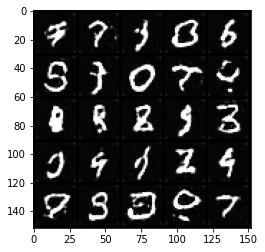

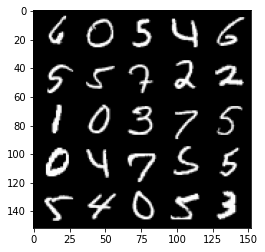

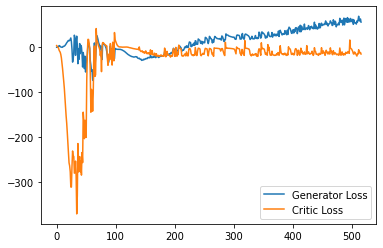

Step 10400: Generator loss: 58.09149803161621, critic loss: -8.184597147464752


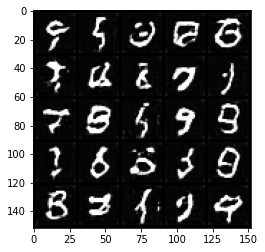

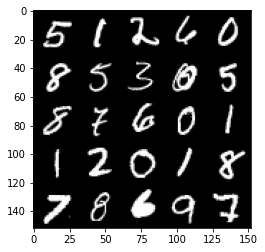

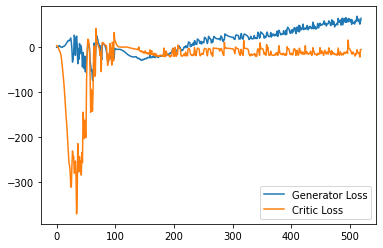

Step 10450: Generator loss: 59.024160919189455, critic loss: -18.491152451038364


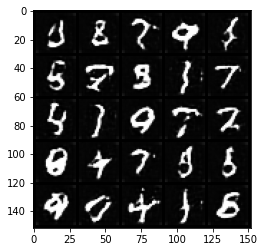

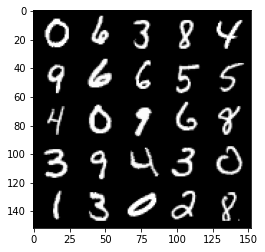

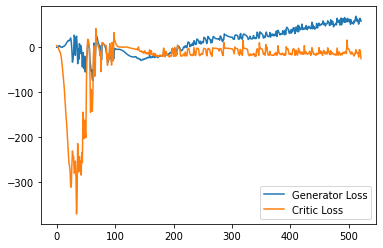

Step 10500: Generator loss: 65.35089004516601, critic loss: -5.159329193592072


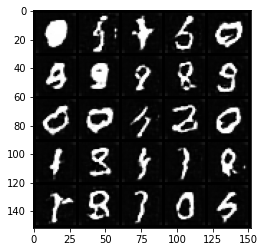

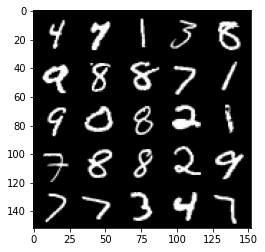

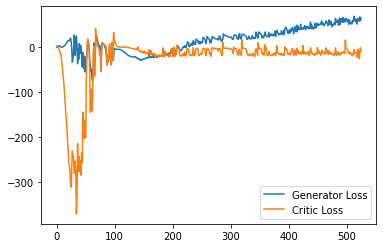

Step 10550: Generator loss: 63.80398338317871, critic loss: -13.862496439456942


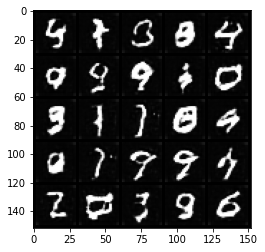

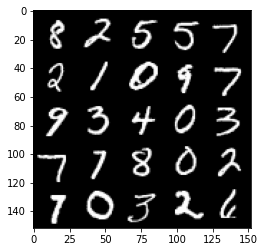

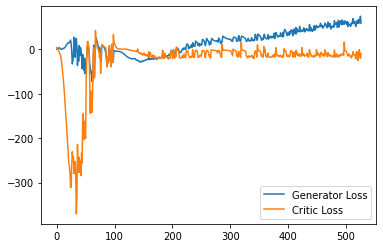

Step 10600: Generator loss: 58.38262367248535, critic loss: -12.046617456436156


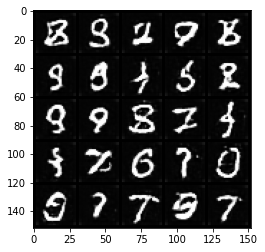

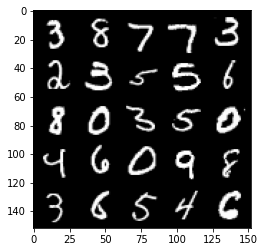

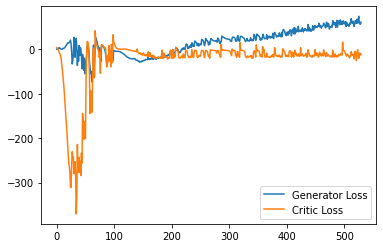

Step 10650: Generator loss: 57.50643074035644, critic loss: -14.754237539291378


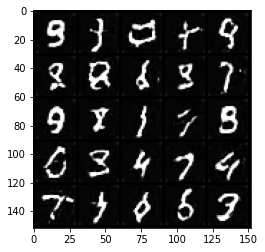

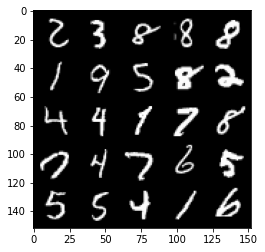

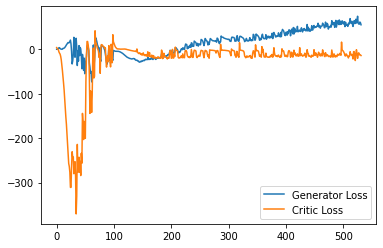

Step 10700: Generator loss: 57.05626174926758, critic loss: -16.32544215631485


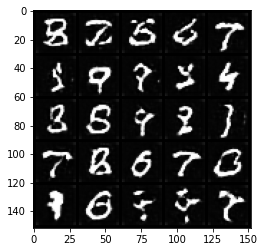

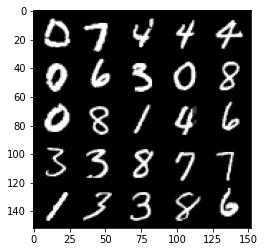

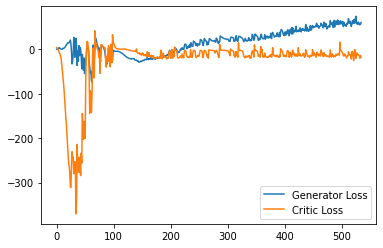

Step 10750: Generator loss: 62.7163793182373, critic loss: -14.707057328224176


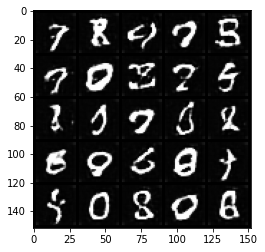

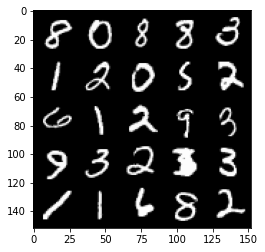

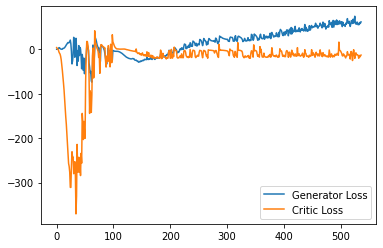

Step 10800: Generator loss: 61.27587097167969, critic loss: -13.432311104774476


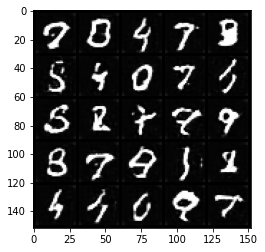

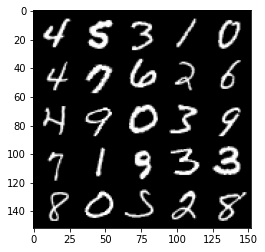

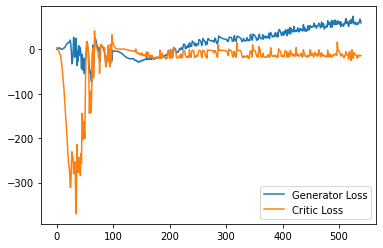

Step 10850: Generator loss: 66.21885620117187, critic loss: -5.22781152868271


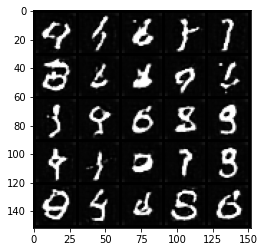

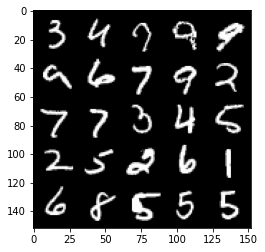

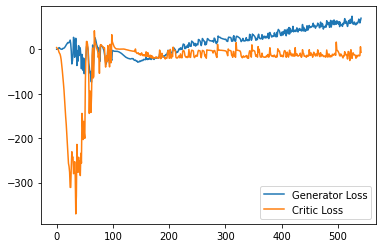

Step 10900: Generator loss: 63.265105361938474, critic loss: -11.865242244005204


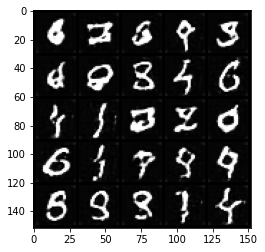

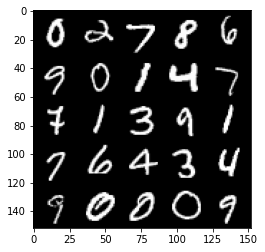

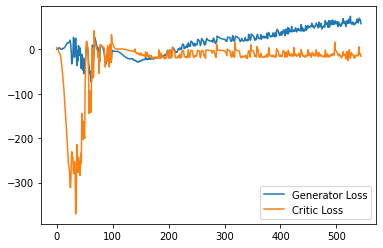

Step 10950: Generator loss: 64.80900573730469, critic loss: -12.81298492908478


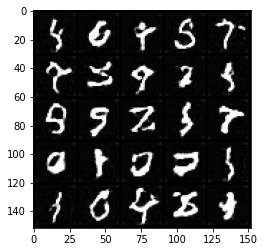

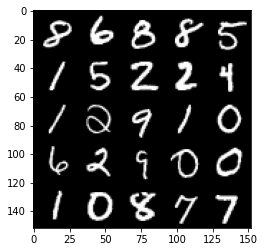

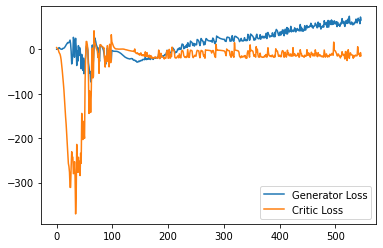

Step 11000: Generator loss: 66.6805802154541, critic loss: -12.001063557624816


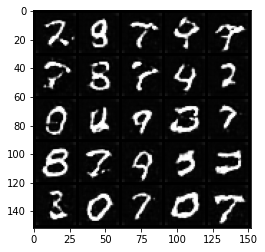

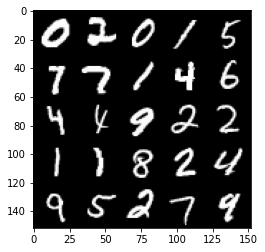

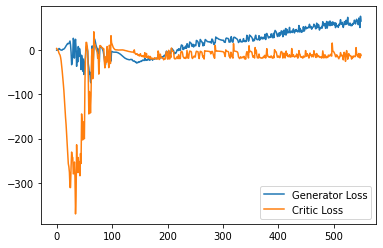

Step 11050: Generator loss: 68.19221855163575, critic loss: -12.725855789661411


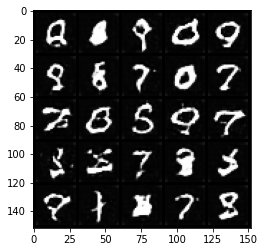

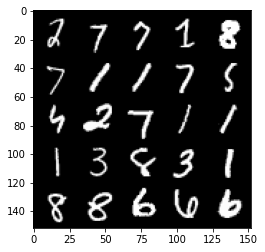

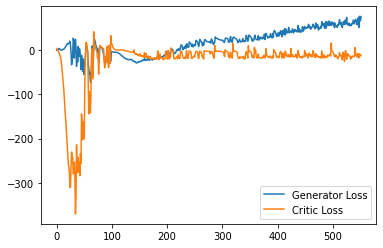

Step 11100: Generator loss: 68.73493370056153, critic loss: -7.531239213347434


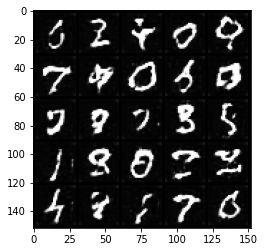

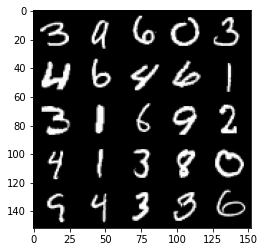

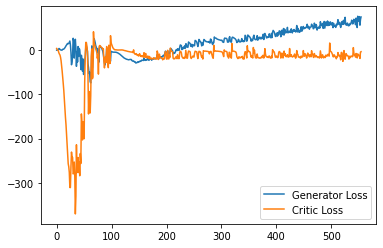

Step 11150: Generator loss: 64.56425903320313, critic loss: -6.39699954009056


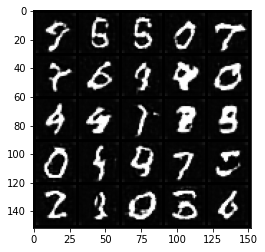

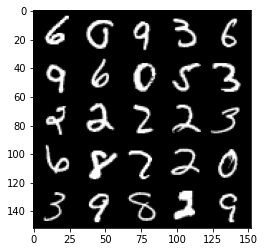

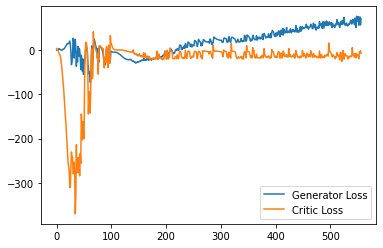

Step 11200: Generator loss: 70.80109252929688, critic loss: -11.421234035015107


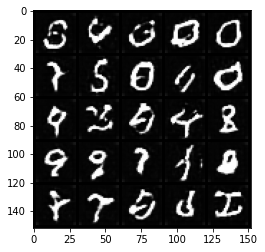

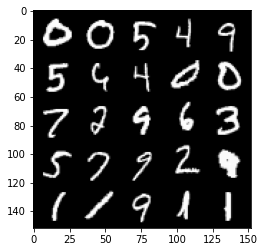

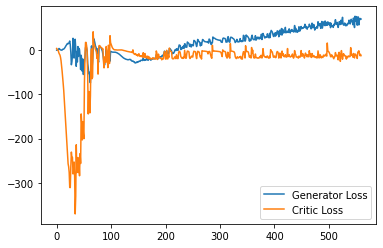

Step 11250: Generator loss: 59.69556404113769, critic loss: -15.816667753458024


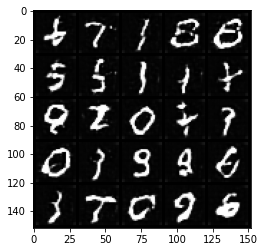

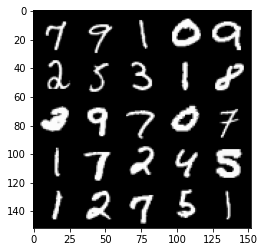

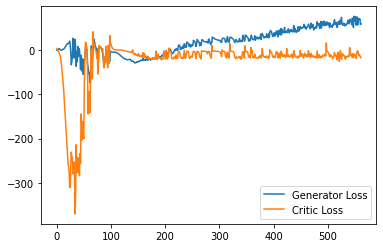

Step 11300: Generator loss: 71.34852325439454, critic loss: -13.24008889555931


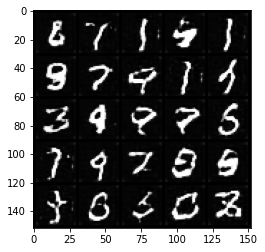

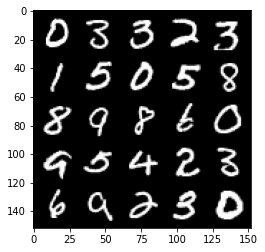

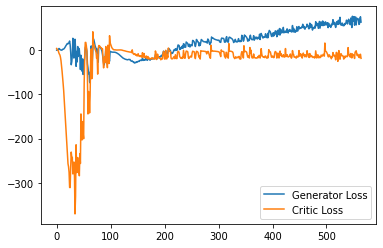

Step 11350: Generator loss: 68.33947456359863, critic loss: -12.973444533824916


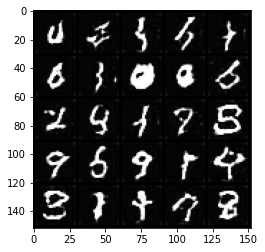

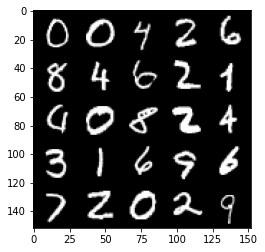

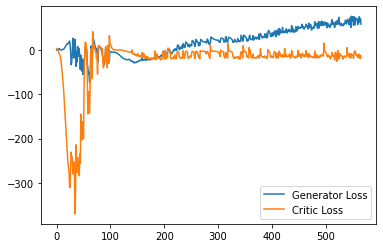

Step 11400: Generator loss: 69.75884811401367, critic loss: -10.900618160247804


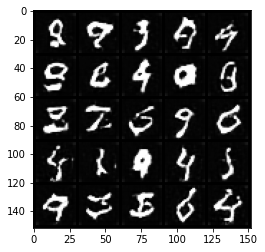

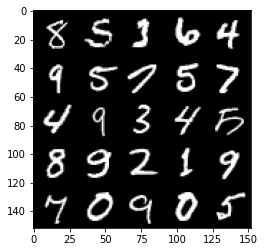

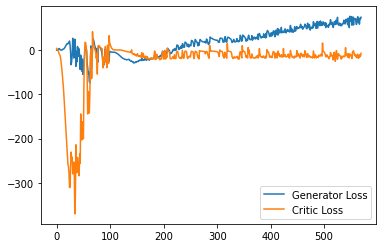

Step 11450: Generator loss: 70.78281318664551, critic loss: -11.401304453611374


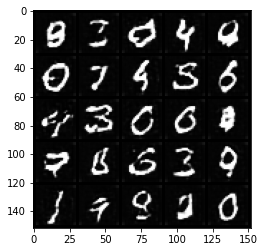

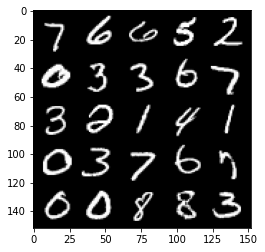

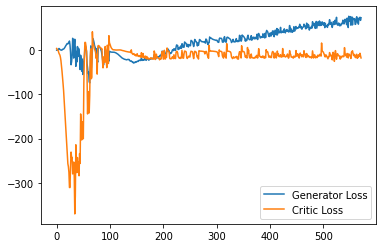

Step 11500: Generator loss: 69.17090911865235, critic loss: -16.147156522512436


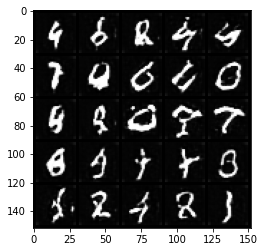

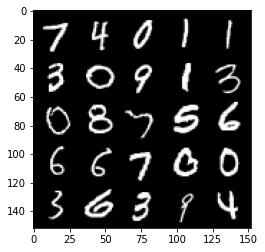

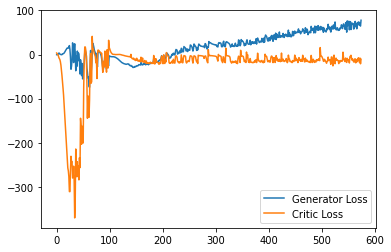

Step 11550: Generator loss: 71.28726905822754, critic loss: -16.692164015769958


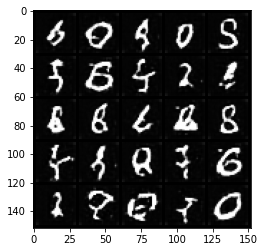

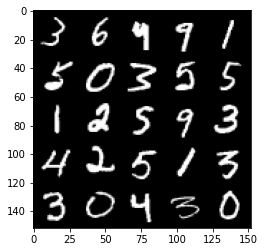

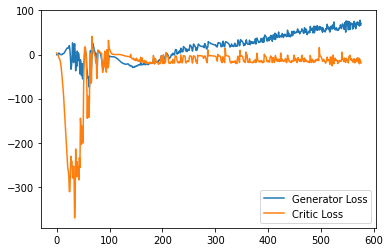

Step 11600: Generator loss: 71.59437934875488, critic loss: -14.135531584024434


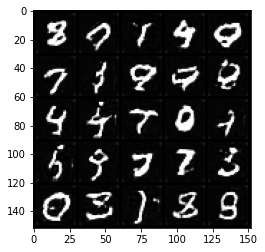

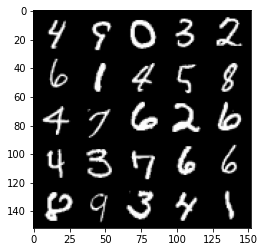

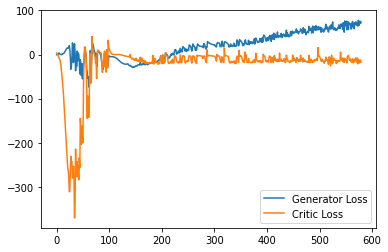

Step 11650: Generator loss: 70.74076324462891, critic loss: -17.175766474246984


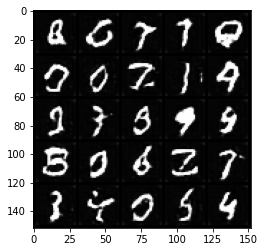

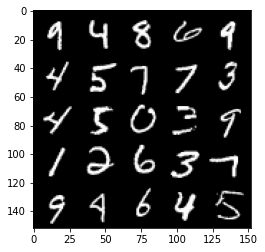

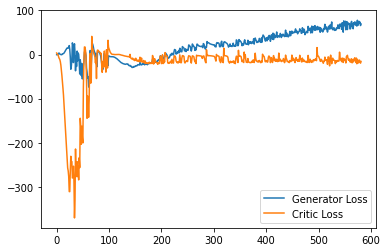

Step 11700: Generator loss: 76.39503082275391, critic loss: -11.688156225919721


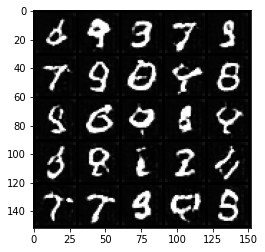

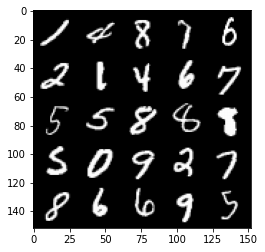

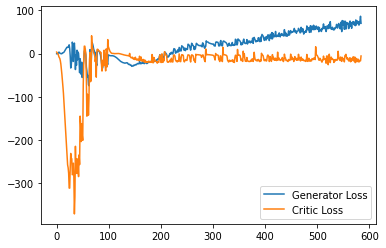

Step 11750: Generator loss: 68.18287826538086, critic loss: -10.1289109711647


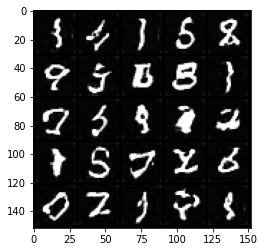

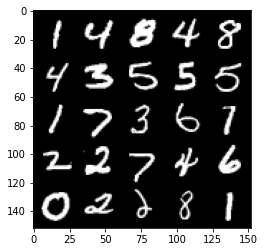

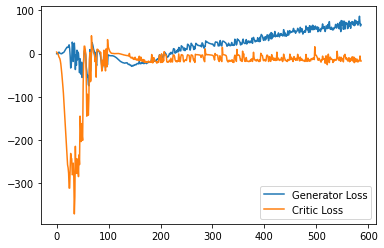

Step 11800: Generator loss: 75.17927192687988, critic loss: -8.571969505310058


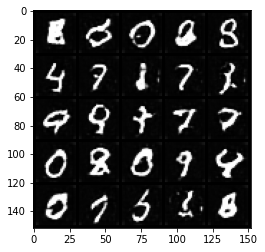

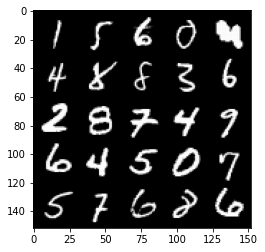

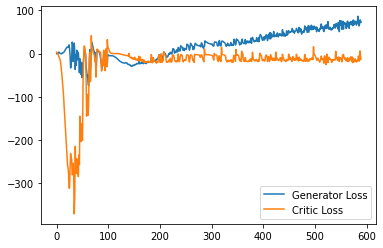

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
